In [ ]:
import os
import torch
import torch.nn as nn
import torch.functional as F
from torch import Tensor
from torch.utils.data import Dataset, DataLoader
from torchvision.transforms import Compose, ToTensor, Normalize

from PIL import Image
import matplotlib.pyplot as plt

In [ ]:

class ConvINR(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, num_hidden_layers, num_hidden_channels=32, bias=True):
        super(ConvINR, self).__init__()

        layers = []
        # initialize 10 input layer and hidden layers
        layers.append(nn.Conv2d(in_channels, num_hidden_channels, kernel_size, padding=kernel_size//2, bias=bias))
        layers.append(nn.BatchNorm2d(num_hidden_channels))
        layers.append(nn.ReLU())

        for i in range(num_hidden_layers):
            layers.append(nn.Conv2d(num_hidden_channels, num_hidden_channels, kernel_size, padding=kernel_size//2, bias=bias))
            layers.append(nn.BatchNorm2d(num_hidden_channels))
            layers.append(nn.ReLU())

        layers.append(nn.Conv2d(num_hidden_channels, out_channels, kernel_size, padding=kernel_size//2, bias=bias))
        self.net = nn.Sequential(*layers)


    def forward(self, coord_grid):
        coord_grid = coord_grid.clone().detach().requires_grad_(True)
        # coord_grid has shape (batch_size, channels=2, height, width)
        output = self.net(coord_grid)
        return output, coord_grid


class ImageFittingCNN(Dataset):
    def __init__(self, img: Tensor):
        width = img.shape[1]
        height = img.shape[2]

        # Create a grid of coordinates
        x_coords = torch.linspace(-1, 1, width)
        y_coords = torch.linspace(-1, 1, height)
        X, Y = torch.meshgrid(x_coords, y_coords)

        self.pixels = img.clone().detach()

        # Should be (W, H, C=2)
        self.coords = torch.stack((X, Y), dim=-1).permute(2, 0, 1)

    def __len__(self):
        return 1

    def __getitem__(self, idx):
        if idx > 0:
            raise IndexError

        return self.coords, self.pixels


def process_image(img: Image):
    transform = Compose([
        ToTensor(),
        Normalize(torch.Tensor([0.5]), torch.Tensor([0.5]))
    ])
    img = transform(img)
    return img


(768, 512)


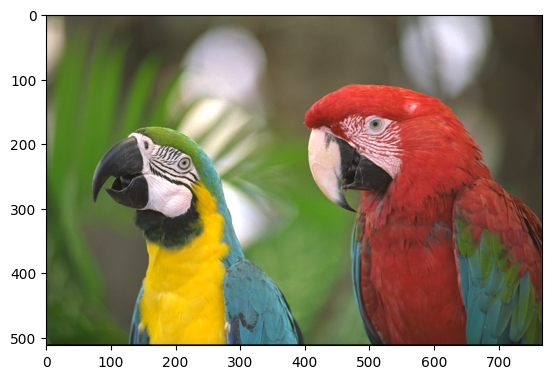

In [ ]:
img = Image.open('kodim23.png')

# display the image inline
plt.imshow(img)
print(img.size)


In [ ]:
img = ImageFittingCNN(process_image(img))

dataloader = DataLoader(img, batch_size=1, pin_memory=True)

img_cnn = ConvINR(in_channels=2, out_channels=3, kernel_size=3,
                  num_hidden_layers=10, num_hidden_channels=32)

# move to GPU if available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
img_cnn.to(device)



ConvINR(
  (net): Sequential(
    (0): Conv2d(2, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU()
    (6): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU()
    (9): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (10): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU()
    (12): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (14): ReLU()
    (15): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), paddin

In [ ]:
coords, pixels = next(iter(dataloader))

coords, pixels = img_cnn(coords)
print(f"output shape: {coords.shape}, pixels shape: {pixels.shape}")

coords shape: torch.Size([1, 2, 512, 768]), pixels shape: torch.Size([1, 3, 512, 768])
output shape: torch.Size([1, 3, 512, 768]), pixels shape: torch.Size([1, 2, 512, 768])


In [ ]:
from tqdm import tqdm

def train_conv_inr(model, optim, loss_fn, dataloader, num_iters, steps_til_summary=100):
    model.train()
    for i in range(num_iters):
        model_input, ground_truth = next(iter(dataloader))
        model_input, ground_truth = model_input.to(device), ground_truth.to(device)

        for step in tqdm(range(num_iters)):
            model_output, coord_grid = img_cnn(model_input)
            loss = loss_fn(model_output, ground_truth)

            if not step % steps_til_summary:
                print("Step %d, Loss %0.6f" % (step, loss.item()))

                fig, axes = plt.subplots(1,2, figsize=(12,6))
                axes[0].imshow(model_output[0].cpu().detach().permute(1,2,0).numpy())
                axes[1].imshow(ground_truth[0].cpu().detach().permute(1,2,0).numpy())
                plt.show()

            optim.zero_grad()
            loss.backward()
            optim.step()

  0%|          | 0/10000 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.5676652].


Step 0, Loss 0.305969


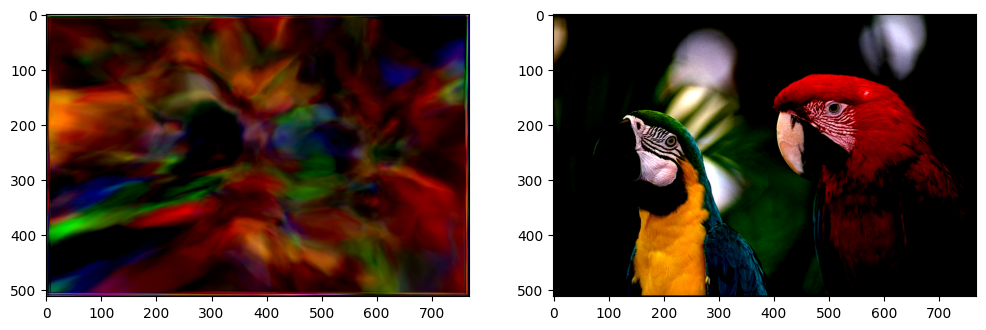

  1%|          | 100/10000 [00:11<19:22,  8.52it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.1801044].


Step 100, Loss 0.178415


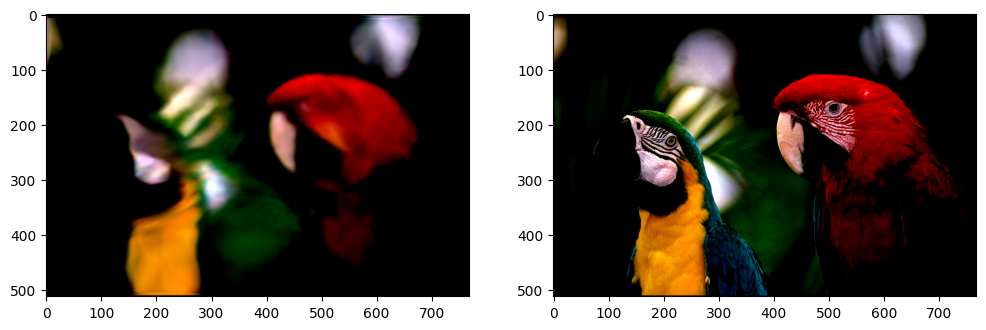

  2%|▏         | 200/10000 [00:23<19:16,  8.47it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.1932555].


Step 200, Loss 0.175791


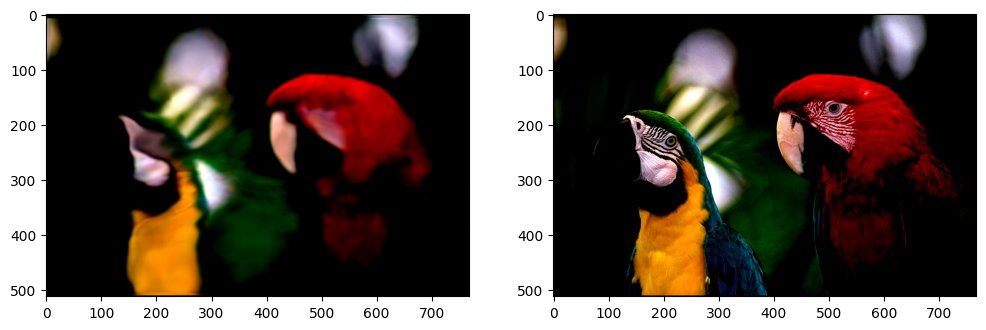

  3%|▎         | 300/10000 [00:35<19:13,  8.41it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2514405].


Step 300, Loss 0.175711


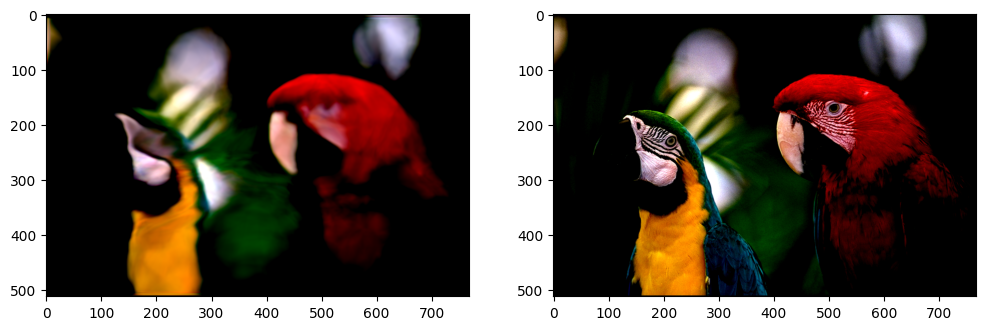

  4%|▍         | 400/10000 [00:48<19:02,  8.40it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.1274761].


Step 400, Loss 0.174856


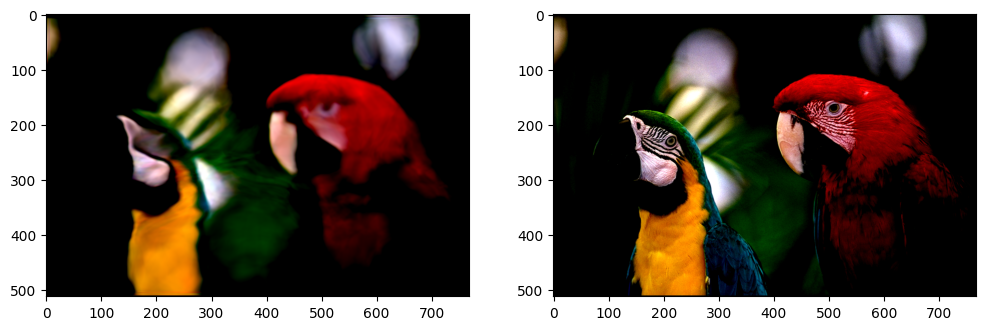

  5%|▌         | 500/10000 [01:00<19:00,  8.33it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.1373861].


Step 500, Loss 0.174389


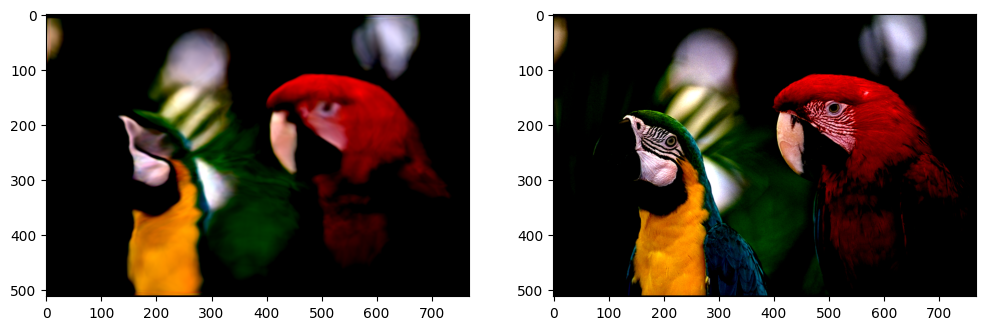

  6%|▌         | 600/10000 [01:12<18:47,  8.34it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2212753].


Step 600, Loss 0.174292


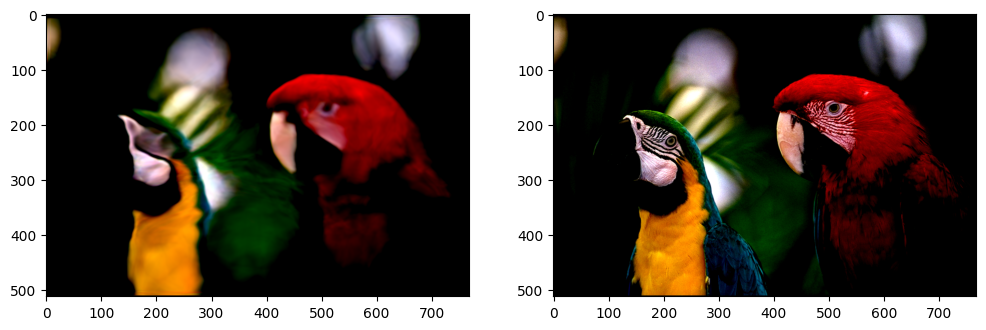

  7%|▋         | 700/10000 [01:25<18:45,  8.26it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2122499].


Step 700, Loss 0.174208


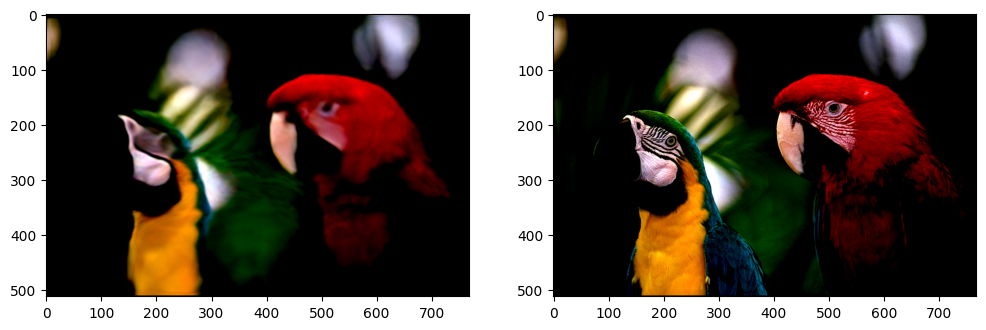

  8%|▊         | 800/10000 [01:37<18:38,  8.23it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2147235].


Step 800, Loss 0.174413


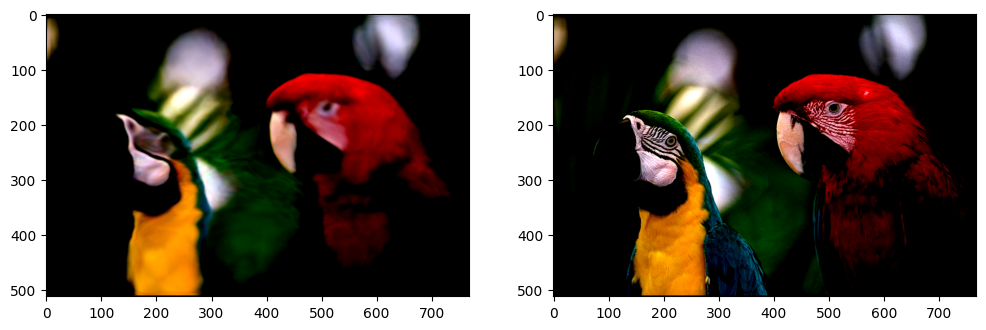

  9%|▉         | 900/10000 [01:50<18:25,  8.23it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.229404].


Step 900, Loss 0.174309


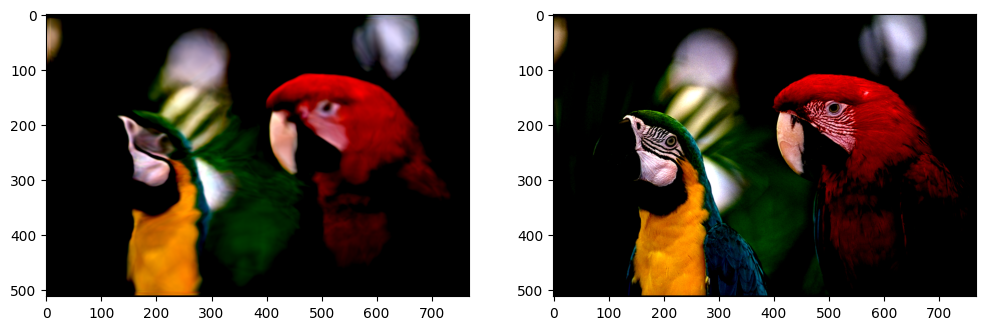

 10%|█         | 1000/10000 [02:02<18:13,  8.23it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2288909].


Step 1000, Loss 0.173765


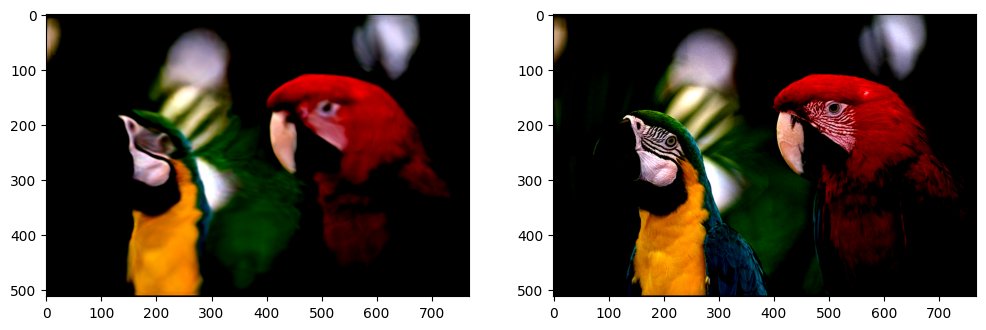

 11%|█         | 1100/10000 [02:15<18:03,  8.21it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2459311].


Step 1100, Loss 0.173864


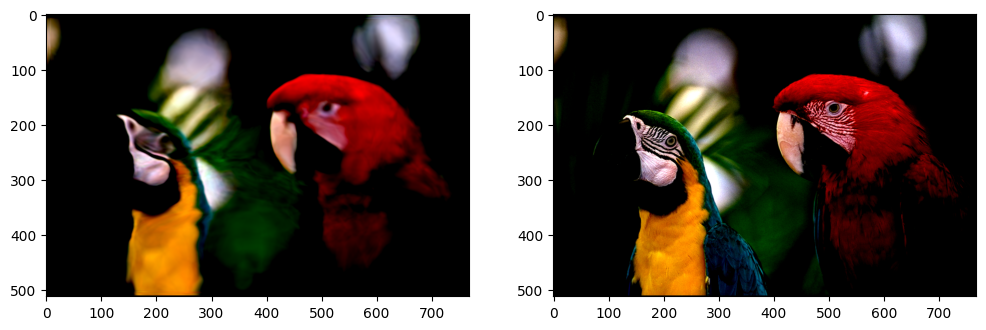

 12%|█▏        | 1200/10000 [02:27<17:56,  8.17it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.207114].


Step 1200, Loss 0.173532


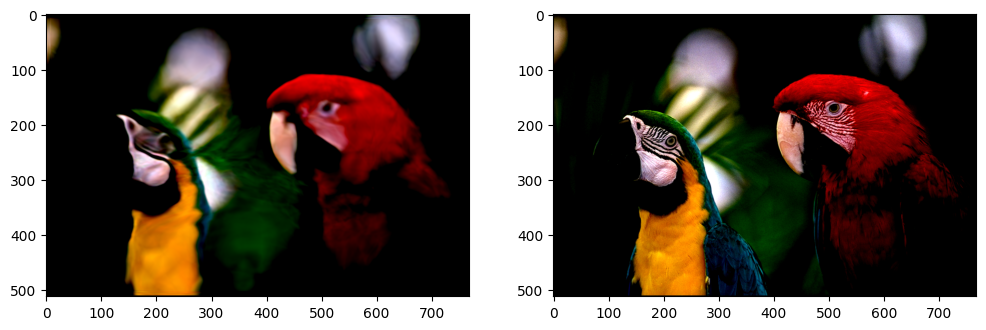

 13%|█▎        | 1300/10000 [02:40<17:47,  8.15it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2117094].


Step 1300, Loss 0.174158


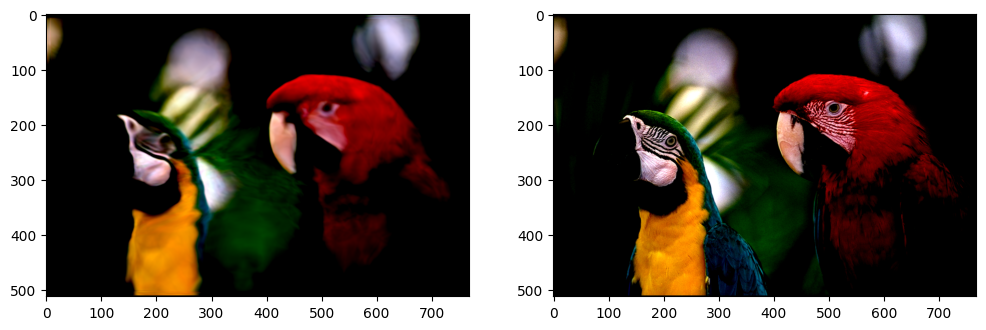

 14%|█▍        | 1400/10000 [02:53<17:40,  8.11it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2712681].


Step 1400, Loss 0.173915


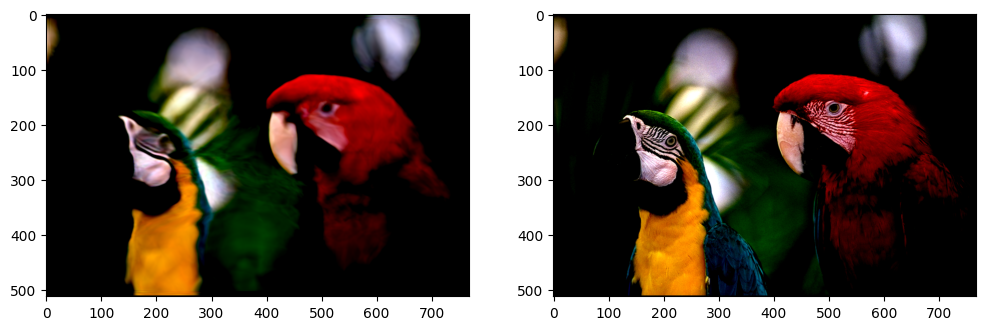

 15%|█▌        | 1500/10000 [03:05<17:30,  8.09it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.1948833].


Step 1500, Loss 0.173328


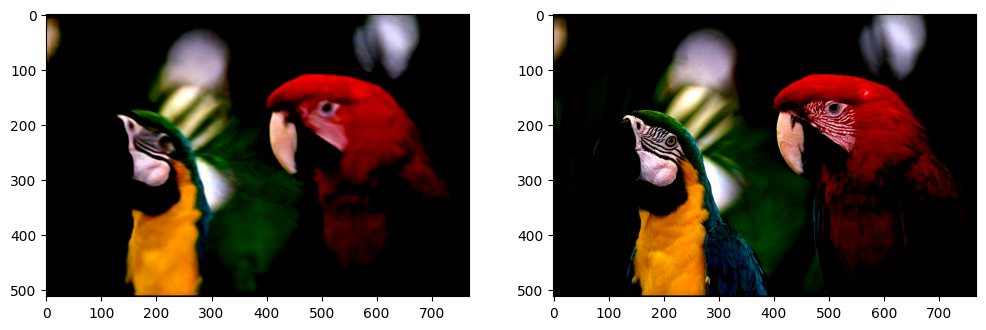

 16%|█▌        | 1600/10000 [03:18<17:20,  8.07it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2275963].


Step 1600, Loss 0.173318


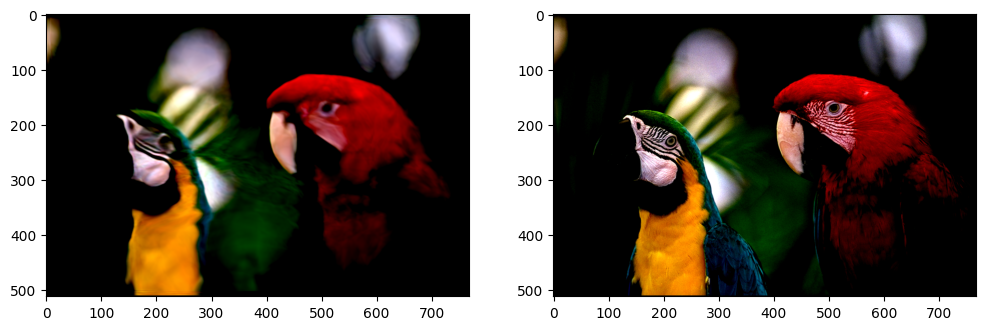

 17%|█▋        | 1700/10000 [03:31<17:09,  8.06it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2661356].


Step 1700, Loss 0.173430


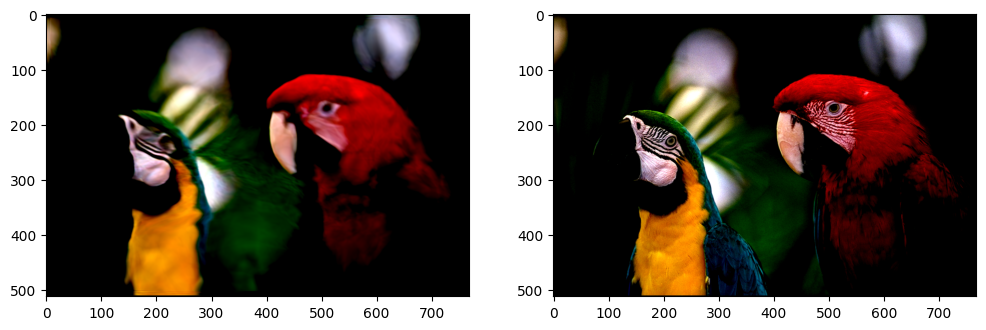

 18%|█▊        | 1800/10000 [03:43<16:55,  8.08it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2273508].


Step 1800, Loss 0.173402


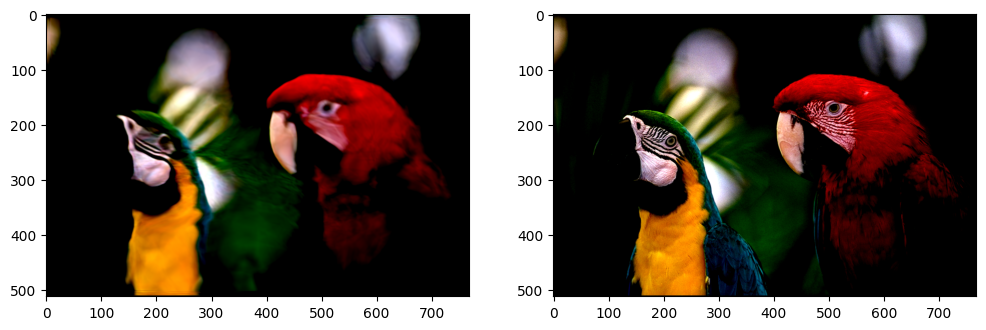

 19%|█▉        | 1900/10000 [03:56<16:39,  8.10it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.3091159].


Step 1900, Loss 0.173240


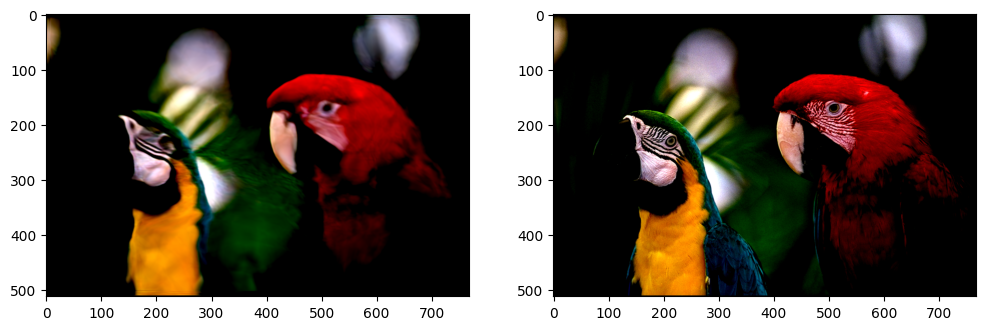

 20%|██        | 2000/10000 [04:09<16:29,  8.08it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2590587].


Step 2000, Loss 0.173038


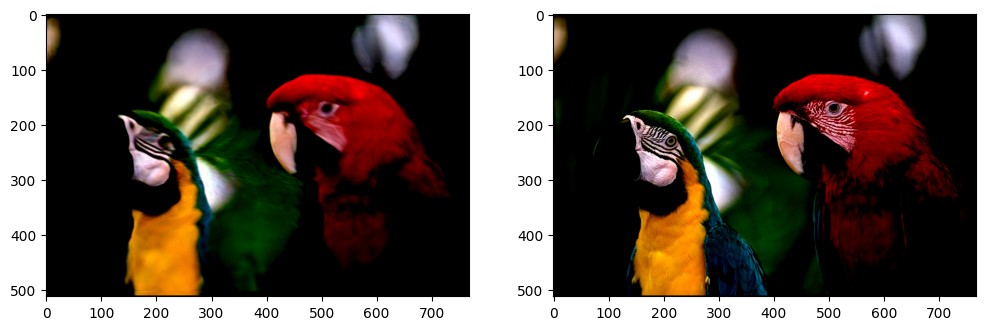

 21%|██        | 2100/10000 [04:22<16:21,  8.05it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.230071].


Step 2100, Loss 0.173369


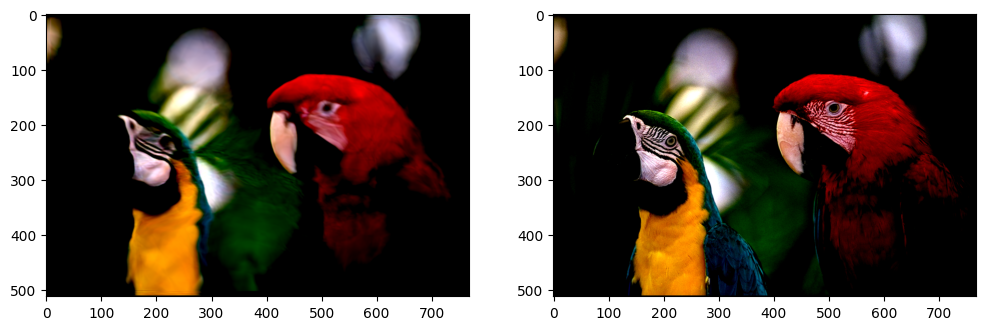

 22%|██▏       | 2200/10000 [04:35<16:10,  8.04it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2647136].


Step 2200, Loss 0.172956


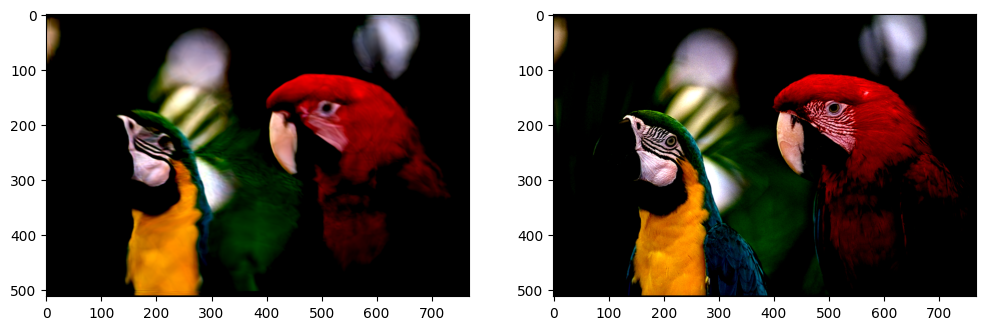

 23%|██▎       | 2300/10000 [04:48<16:00,  8.01it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2825205].


Step 2300, Loss 0.172892


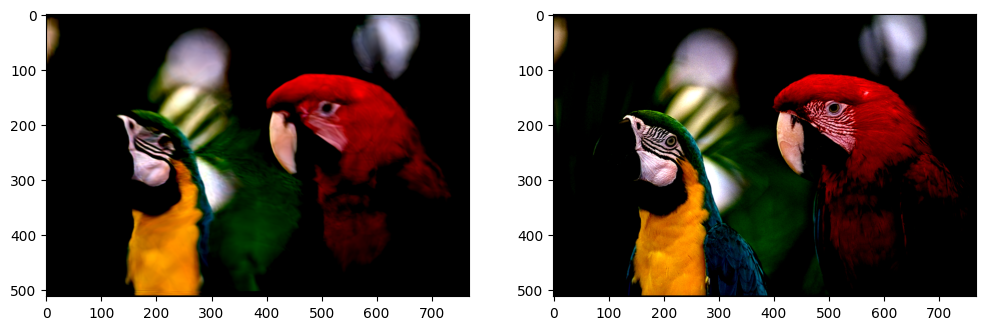

 24%|██▍       | 2400/10000 [05:01<15:51,  7.99it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2274723].


Step 2400, Loss 0.172817


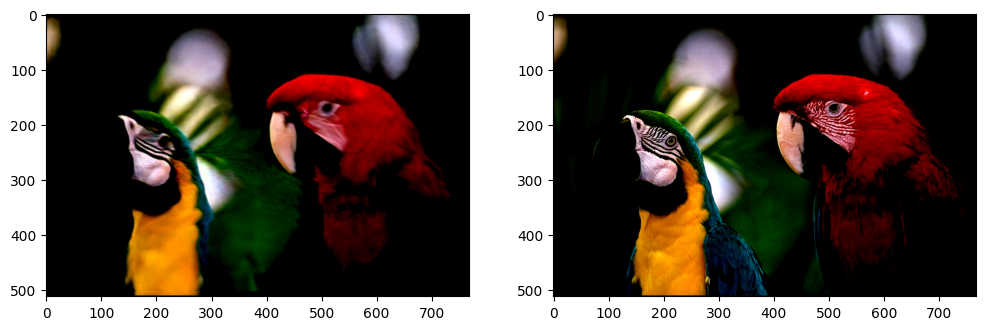

 25%|██▌       | 2500/10000 [05:14<15:34,  8.03it/s]

Step 2500, Loss 0.172978


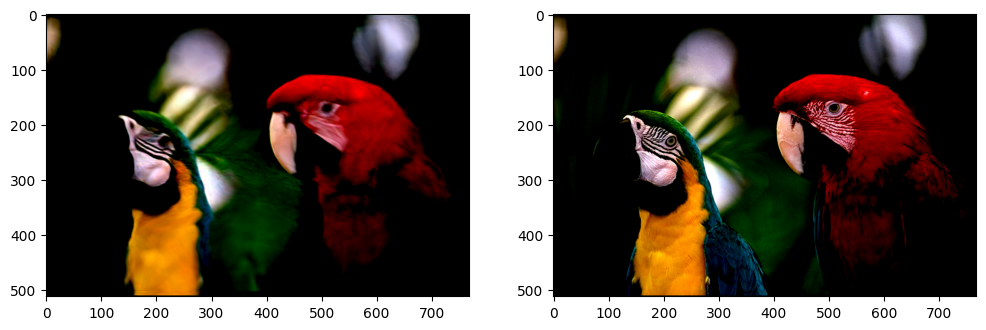

 26%|██▌       | 2600/10000 [05:27<15:25,  7.99it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2612647].


Step 2600, Loss 0.172684


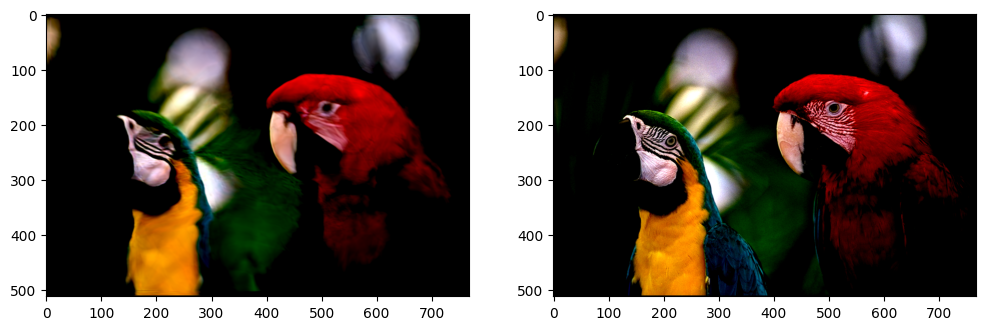

 27%|██▋       | 2700/10000 [05:40<15:10,  8.02it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.1663127].


Step 2700, Loss 0.172967


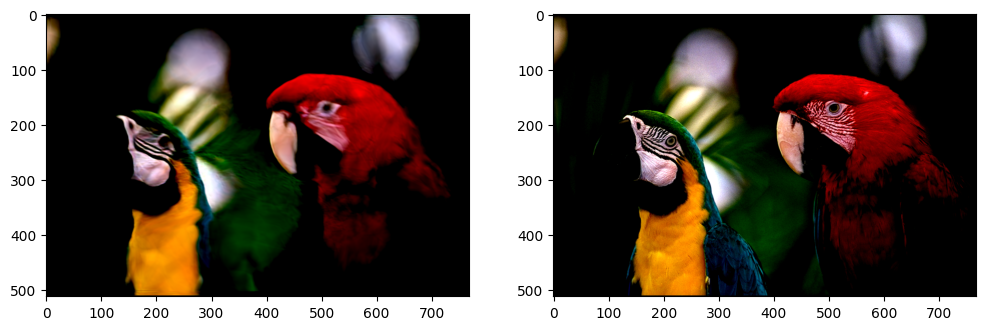

 28%|██▊       | 2800/10000 [05:53<14:58,  8.02it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.1649595].


Step 2800, Loss 0.174740


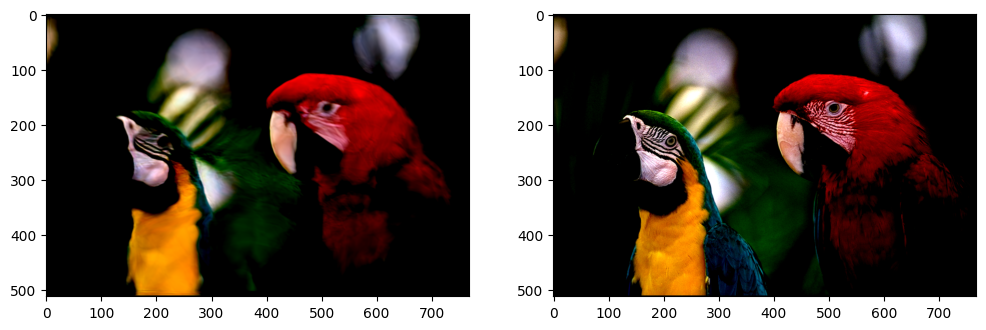

 29%|██▉       | 2900/10000 [06:06<14:47,  8.00it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.1646509].


Step 2900, Loss 0.172824


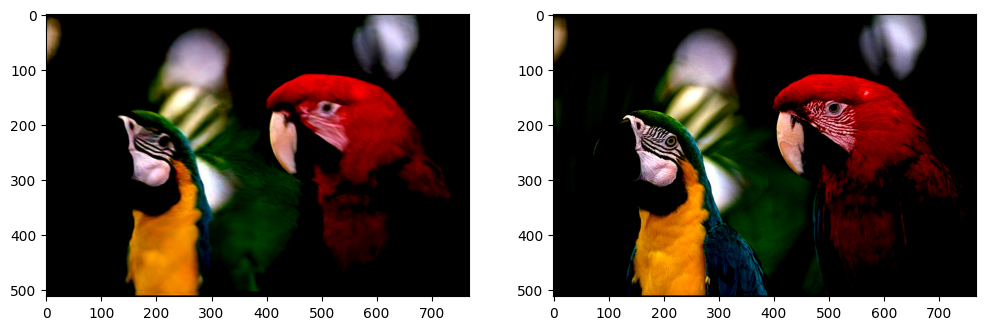

 30%|███       | 3000/10000 [06:19<14:35,  8.00it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.237634].


Step 3000, Loss 0.172743


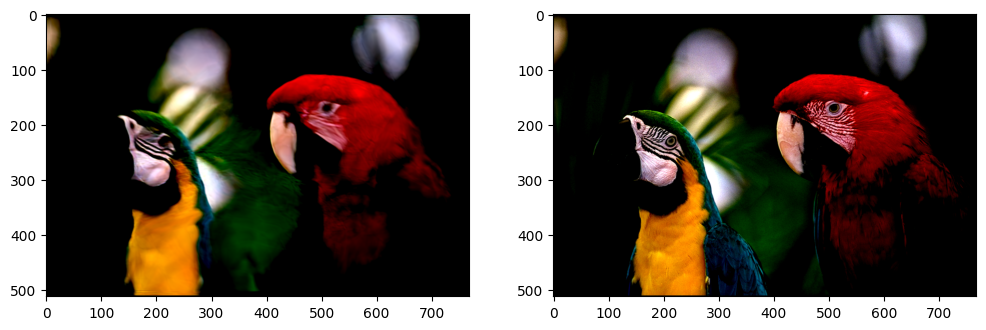

 31%|███       | 3100/10000 [06:32<14:18,  8.04it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.1758635].


Step 3100, Loss 0.172743


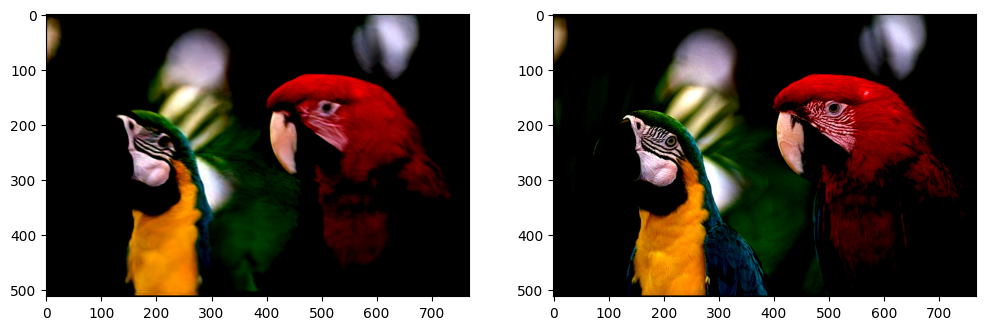

 32%|███▏      | 3200/10000 [06:44<14:06,  8.03it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2762445].


Step 3200, Loss 0.172874


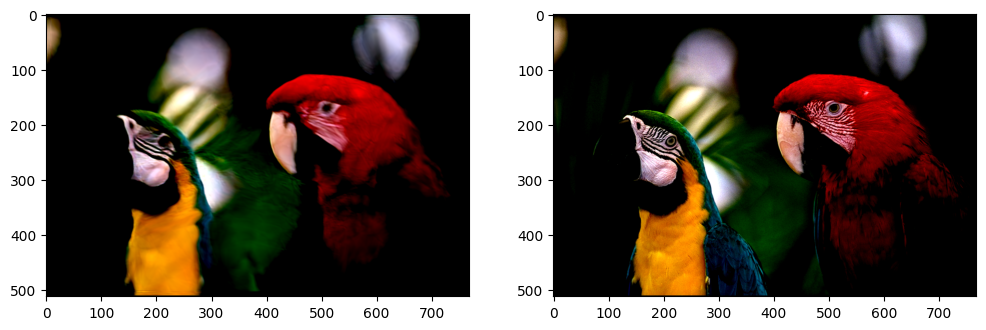

 33%|███▎      | 3300/10000 [06:57<13:59,  7.98it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.1592512].


Step 3300, Loss 0.172779


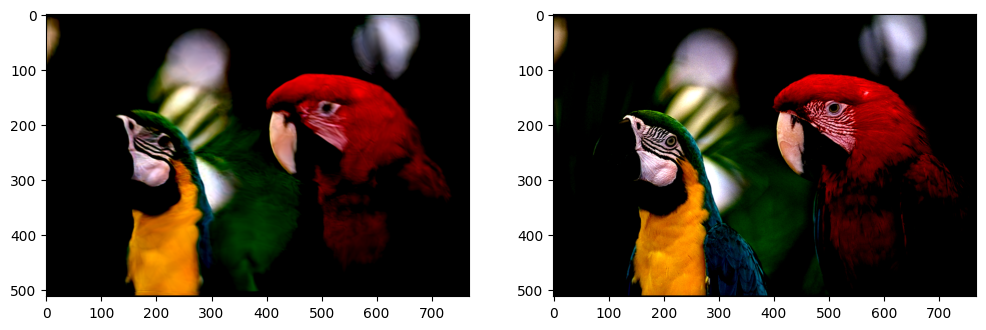

 34%|███▍      | 3400/10000 [07:10<13:45,  8.00it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.1928694].


Step 3400, Loss 0.172511


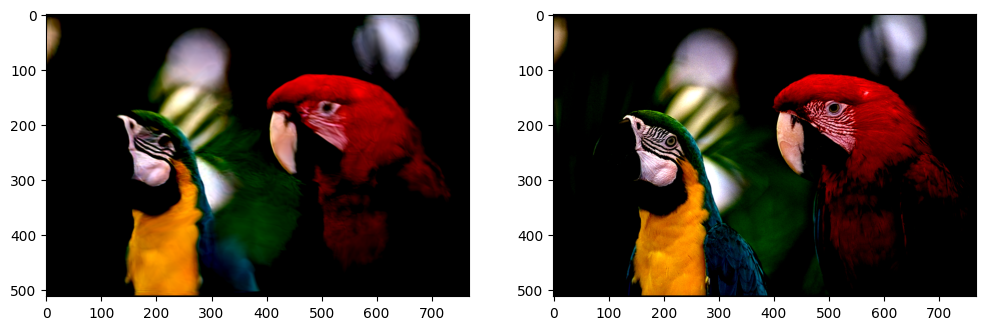

 35%|███▌      | 3500/10000 [07:23<13:31,  8.01it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2115692].


Step 3500, Loss 0.172553


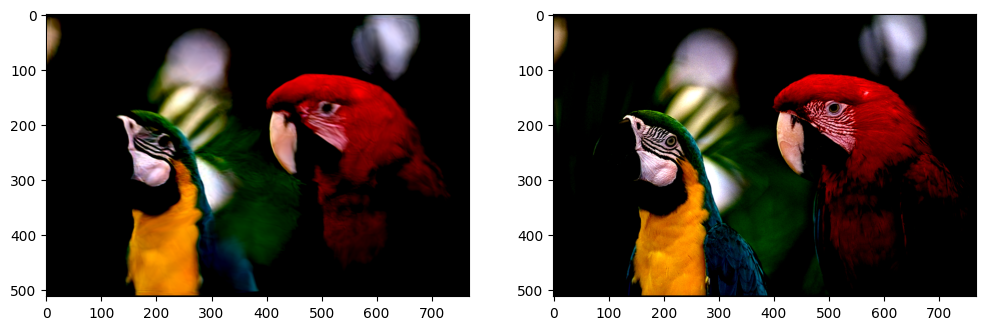

 36%|███▌      | 3600/10000 [07:36<13:22,  7.98it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.1938093].


Step 3600, Loss 0.172708


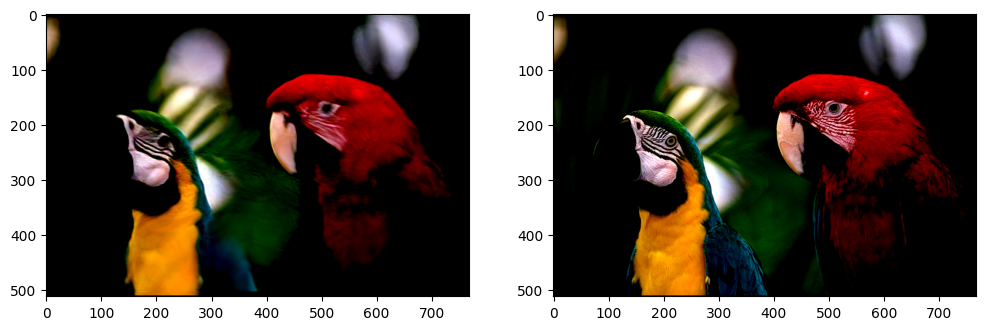

 37%|███▋      | 3700/10000 [07:49<13:11,  7.96it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.3053007].


Step 3700, Loss 0.172792


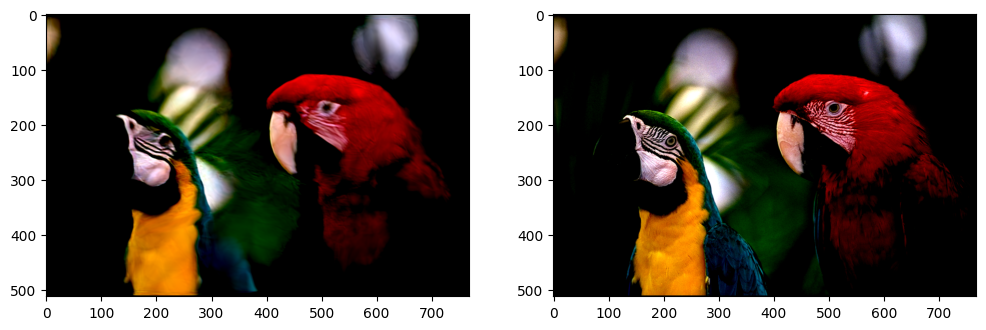

 38%|███▊      | 3800/10000 [08:02<12:59,  7.95it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.1910697].


Step 3800, Loss 0.172316


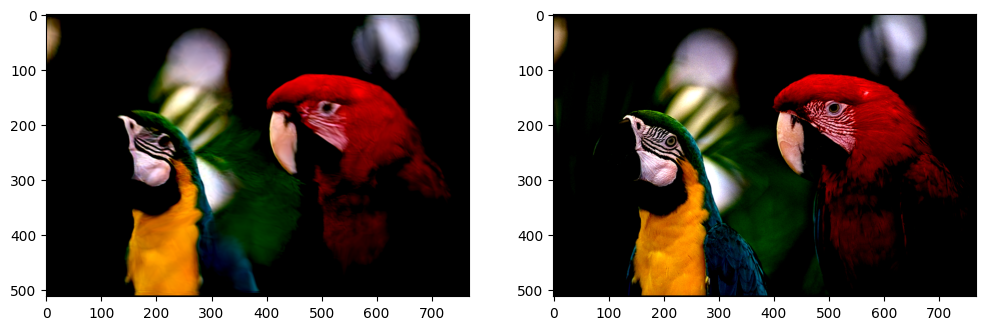

 39%|███▉      | 3900/10000 [08:15<12:46,  7.96it/s]

Step 3900, Loss 0.172289


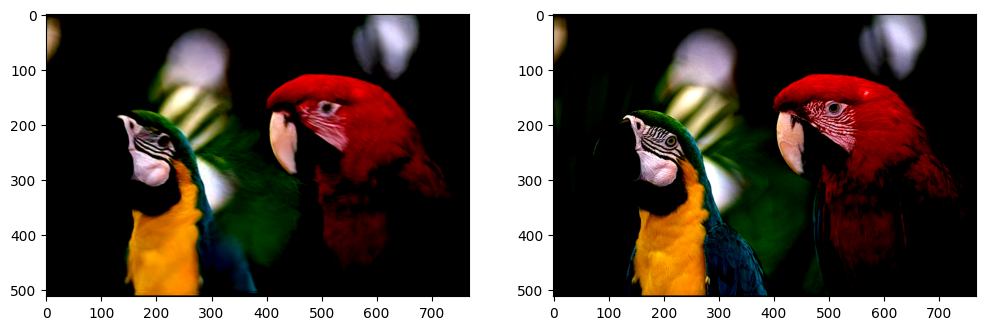

 40%|████      | 4000/10000 [08:28<12:30,  8.00it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.1863805].


Step 4000, Loss 0.172261


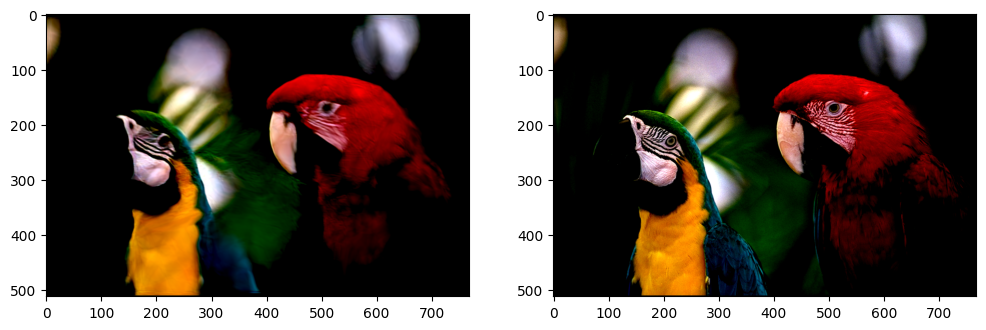

 41%|████      | 4100/10000 [08:41<12:18,  7.99it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.1660521].


Step 4100, Loss 0.172434


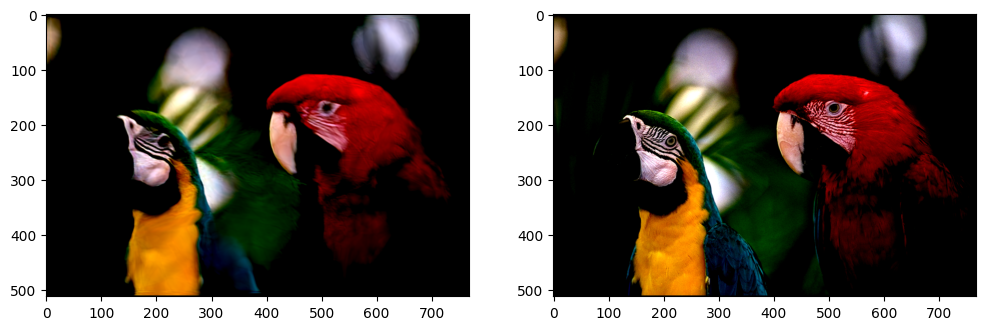

 42%|████▏     | 4200/10000 [08:54<12:08,  7.96it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2075934].


Step 4200, Loss 0.172198


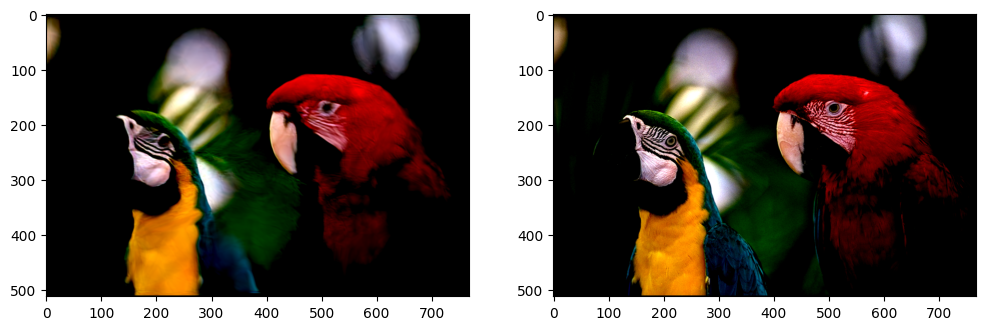

 43%|████▎     | 4300/10000 [09:07<11:56,  7.96it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.1870664].


Step 4300, Loss 0.172475


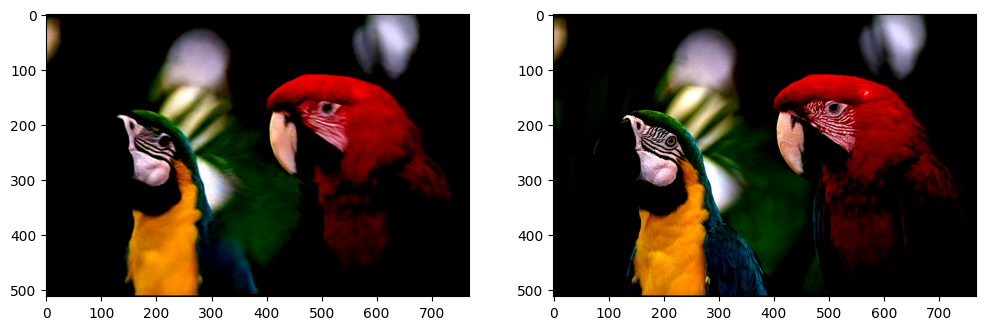

 44%|████▍     | 4400/10000 [09:20<11:41,  7.99it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2638254].


Step 4400, Loss 0.173614


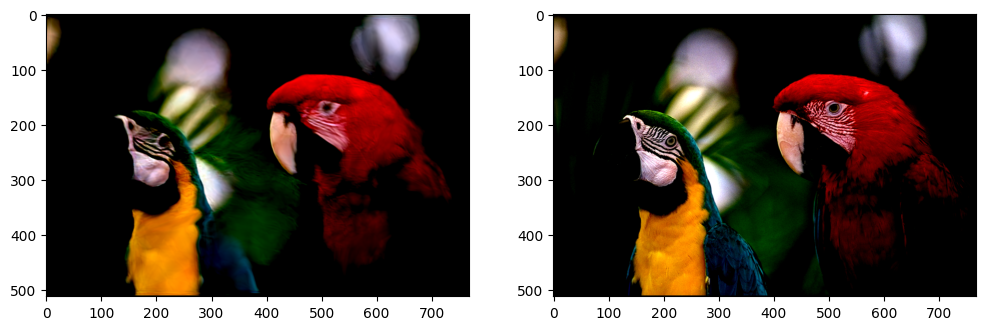

 45%|████▌     | 4500/10000 [09:33<11:30,  7.97it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2352126].


Step 4500, Loss 0.172170


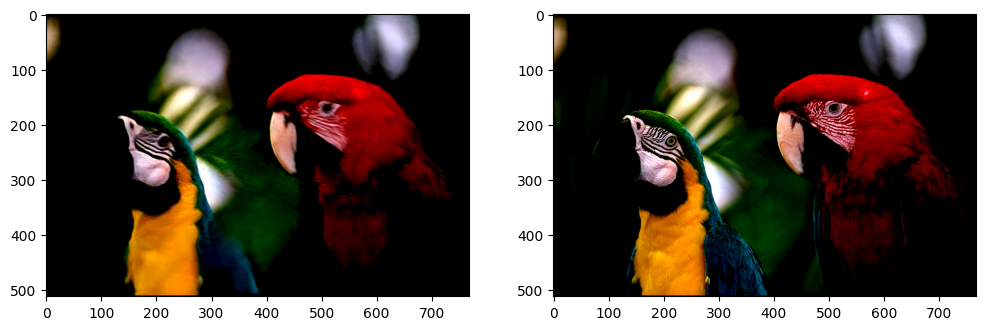

 46%|████▌     | 4600/10000 [09:46<11:18,  7.96it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.1866003].


Step 4600, Loss 0.172358


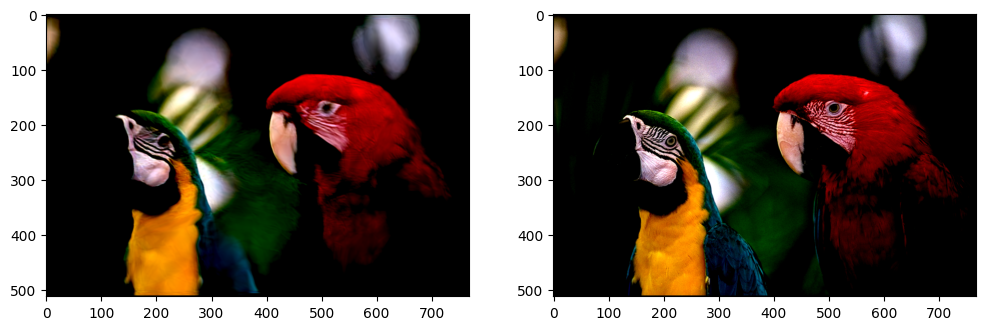

 47%|████▋     | 4700/10000 [09:59<11:02,  8.00it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.1941128].


Step 4700, Loss 0.172398


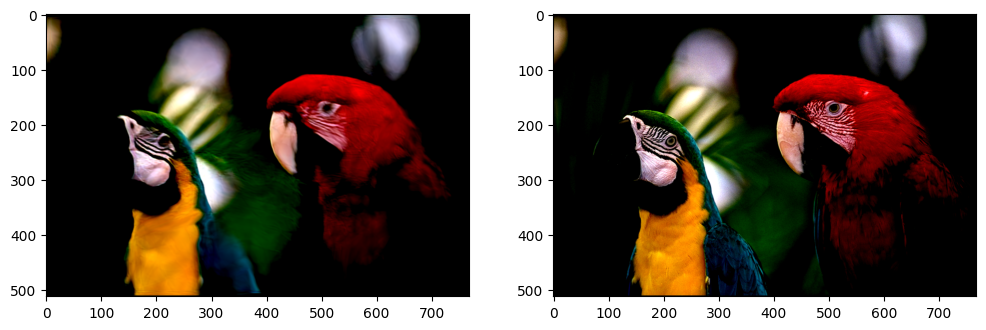

 48%|████▊     | 4800/10000 [10:12<10:52,  7.97it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.1982452].


Step 4800, Loss 0.172139


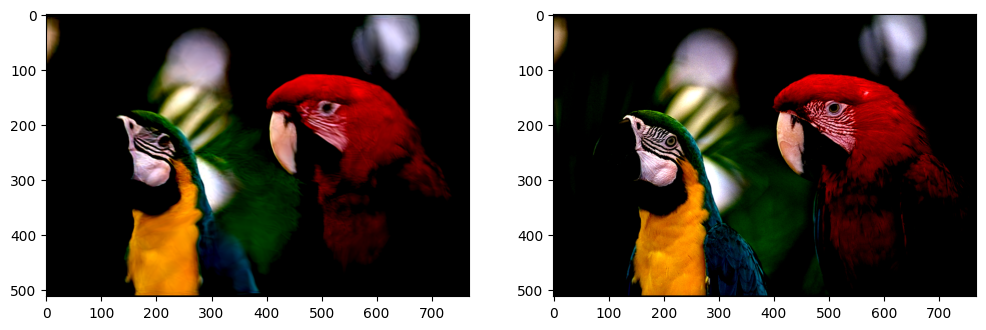

 49%|████▉     | 4900/10000 [10:25<10:39,  7.98it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.210297].


Step 4900, Loss 0.172148


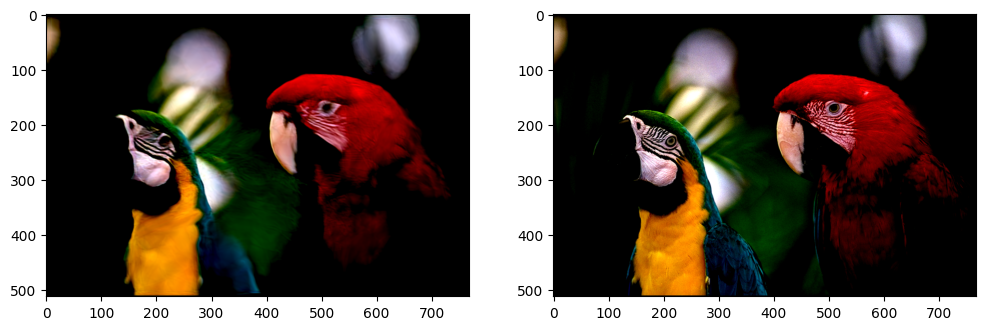

 50%|█████     | 5000/10000 [10:38<10:28,  7.96it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.248614].


Step 5000, Loss 0.172205


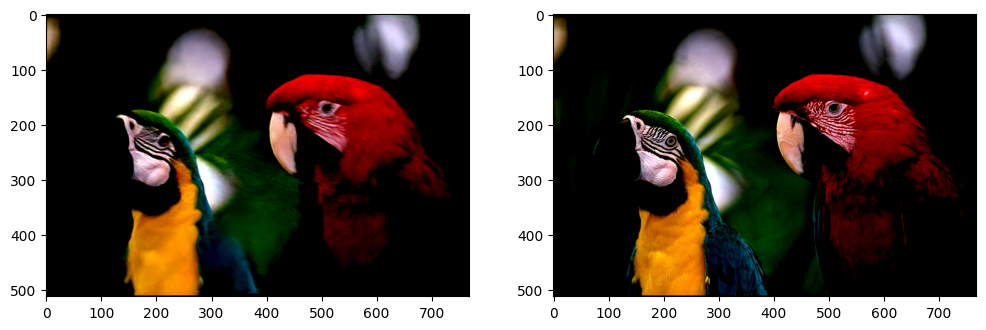

 51%|█████     | 5100/10000 [10:51<10:12,  7.99it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2795081].


Step 5100, Loss 0.172732


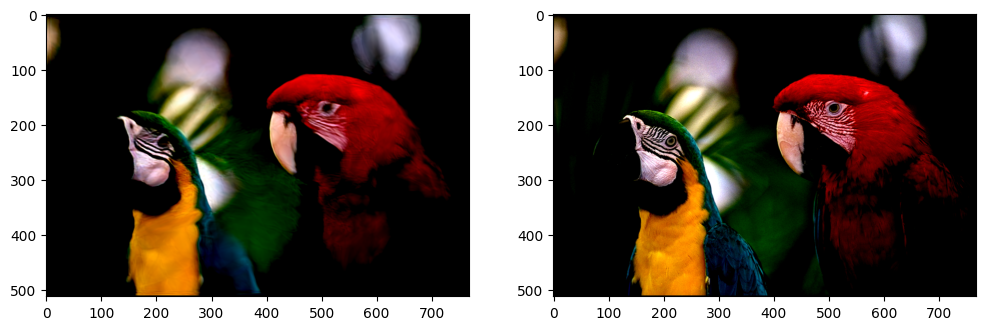

 52%|█████▏    | 5200/10000 [11:04<10:02,  7.97it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.1529318].


Step 5200, Loss 0.172461


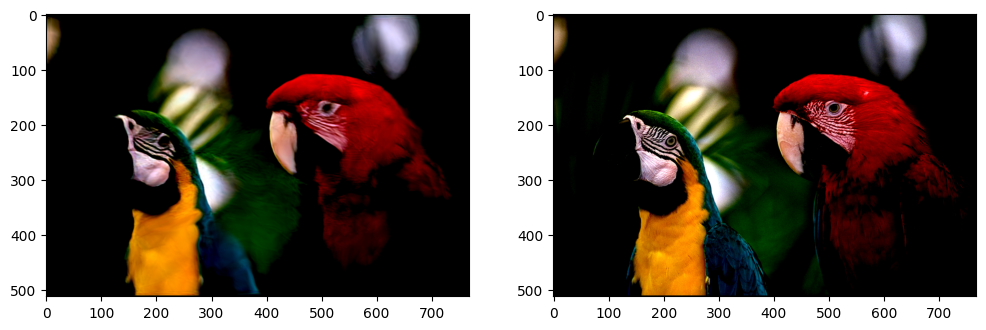

 53%|█████▎    | 5300/10000 [11:17<09:50,  7.96it/s]

Step 5300, Loss 0.172103


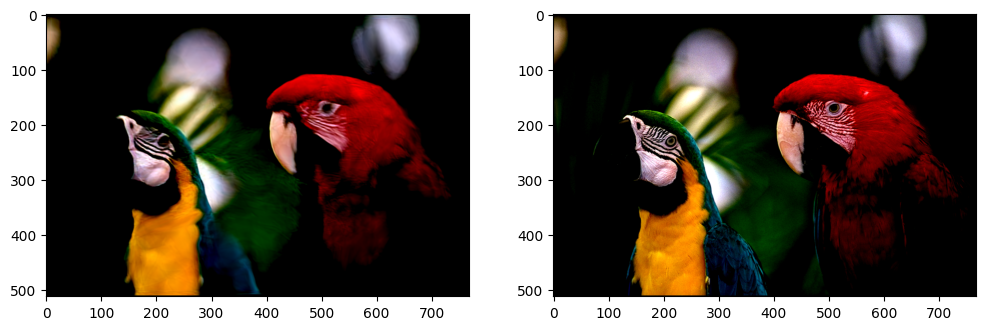

 54%|█████▍    | 5400/10000 [11:31<09:34,  8.01it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.1895083].


Step 5400, Loss 0.172272


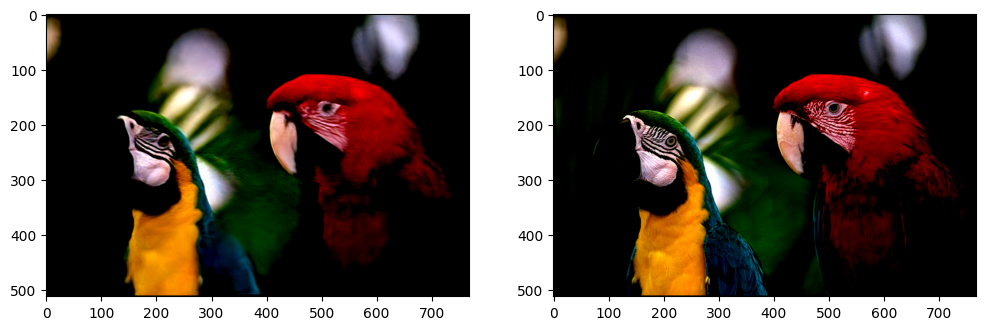

 55%|█████▌    | 5500/10000 [11:44<09:25,  7.96it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.291703].


Step 5500, Loss 0.172140


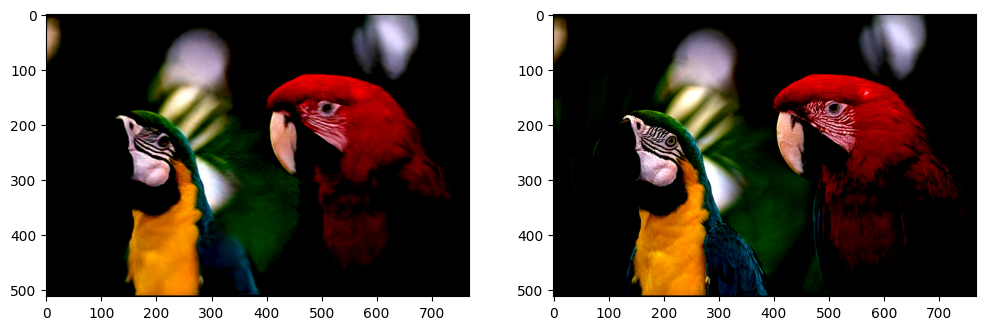

 56%|█████▌    | 5600/10000 [11:57<09:10,  7.99it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.1623842].


Step 5600, Loss 0.171991


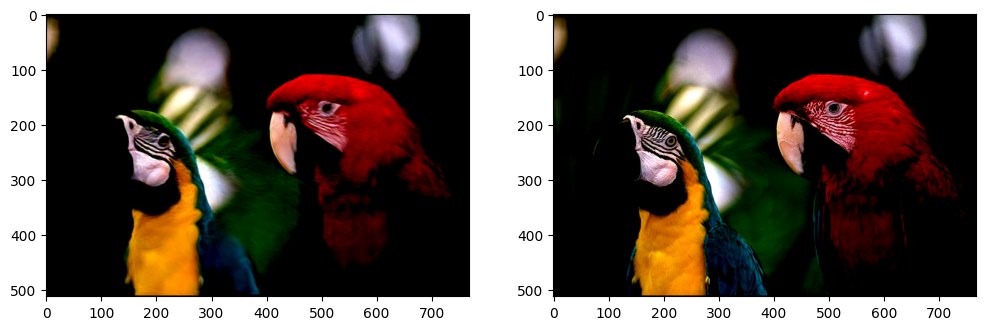

 57%|█████▋    | 5700/10000 [12:10<08:57,  8.00it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.1473753].


Step 5700, Loss 0.172082


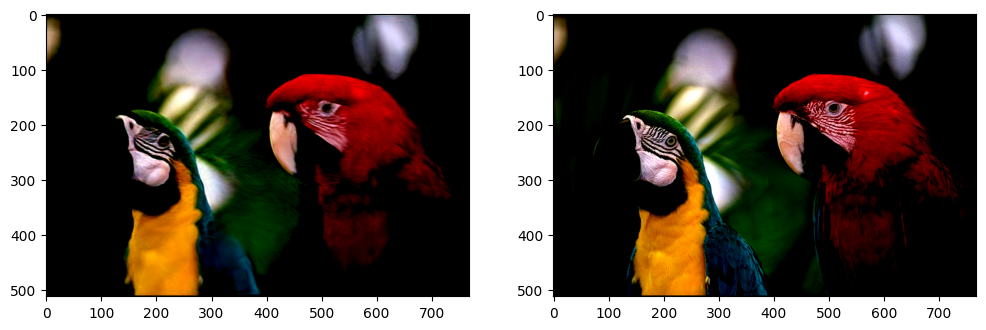

 58%|█████▊    | 5800/10000 [12:23<08:47,  7.96it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2290817].


Step 5800, Loss 0.172058


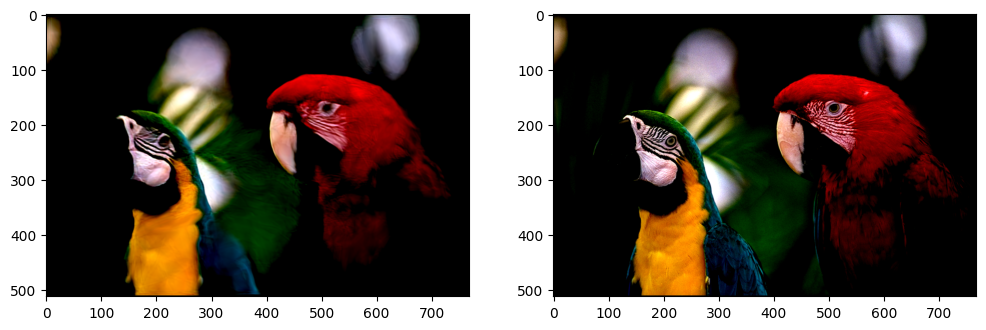

 59%|█████▉    | 5900/10000 [12:36<08:36,  7.94it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.1731263].


Step 5900, Loss 0.172108


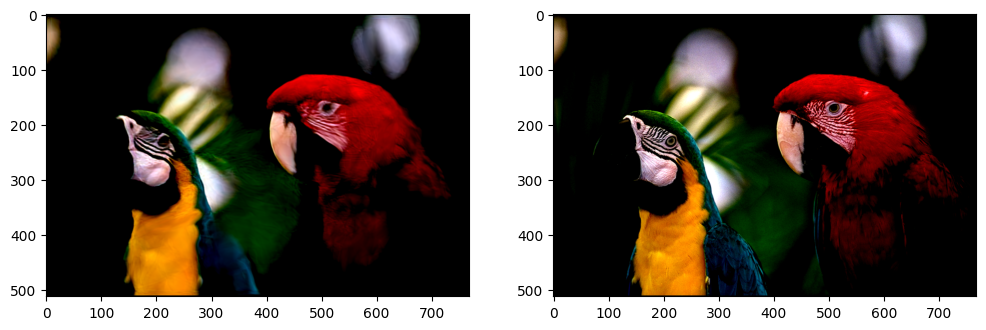

 60%|██████    | 6000/10000 [12:49<08:22,  7.96it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2109922].


Step 6000, Loss 0.172095


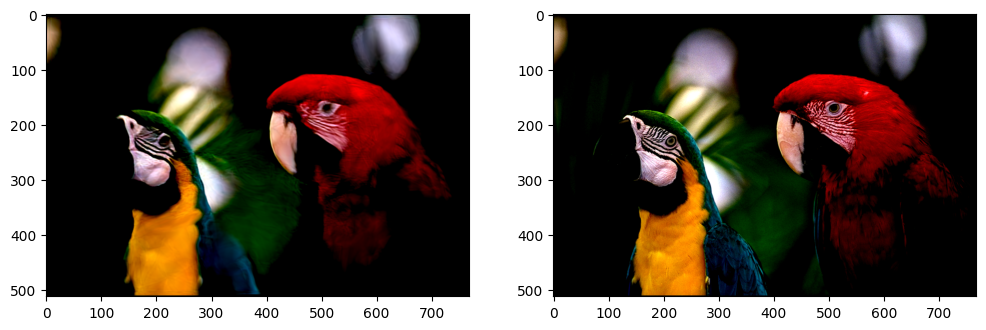

 61%|██████    | 6100/10000 [13:02<08:08,  7.98it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2485797].


Step 6100, Loss 0.172051


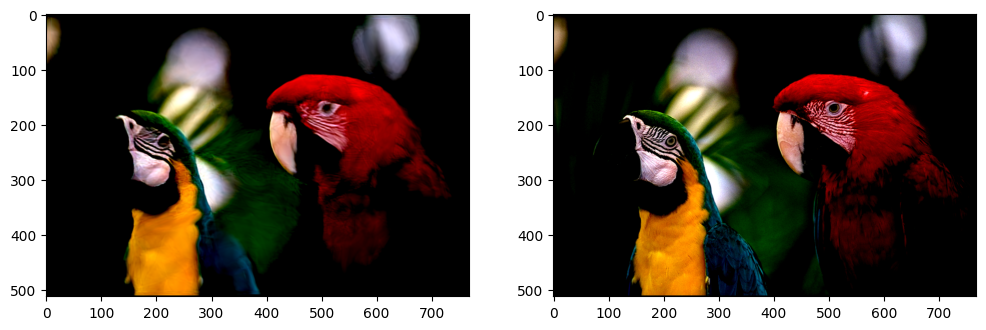

 62%|██████▏   | 6200/10000 [13:15<07:57,  7.96it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.1840196].


Step 6200, Loss 0.172138


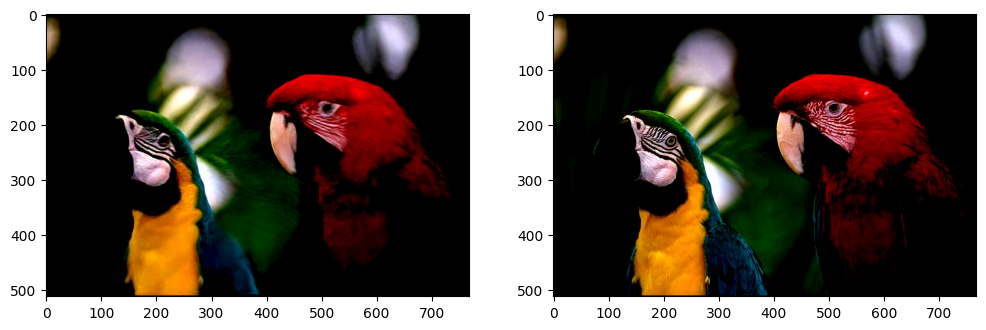

 63%|██████▎   | 6300/10000 [13:28<07:45,  7.95it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2171803].


Step 6300, Loss 0.172149


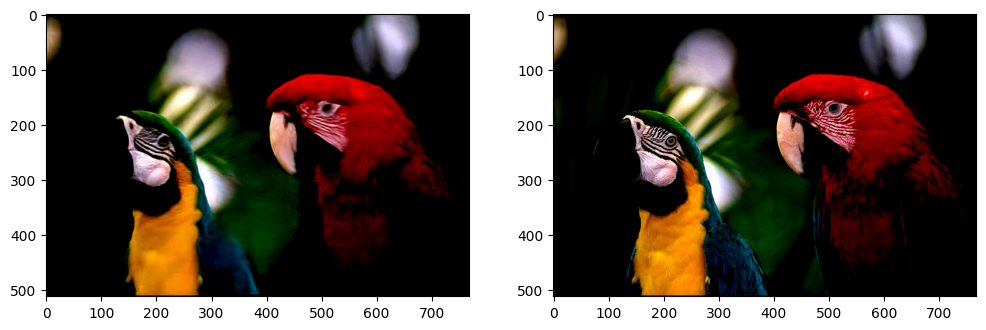

 64%|██████▍   | 6400/10000 [13:41<07:31,  7.97it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2220682].


Step 6400, Loss 0.172022


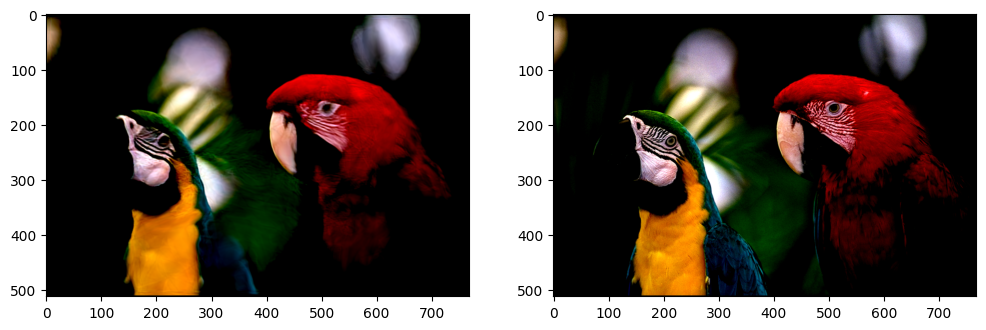

 65%|██████▌   | 6500/10000 [13:54<07:19,  7.96it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.1888202].


Step 6500, Loss 0.171929


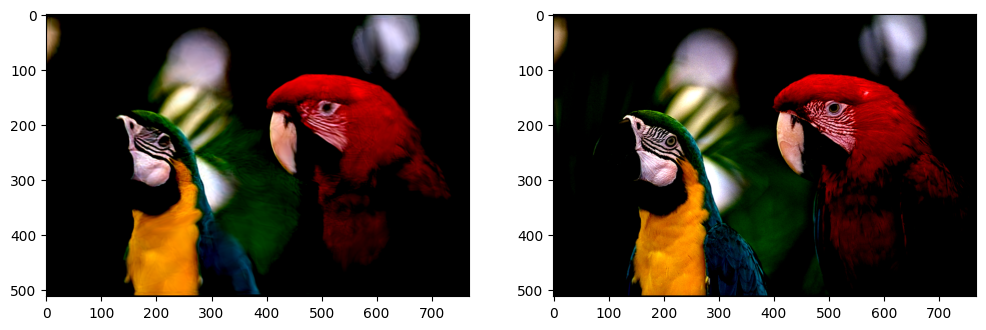

 66%|██████▌   | 6600/10000 [14:07<07:07,  7.96it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2219254].


Step 6600, Loss 0.171953


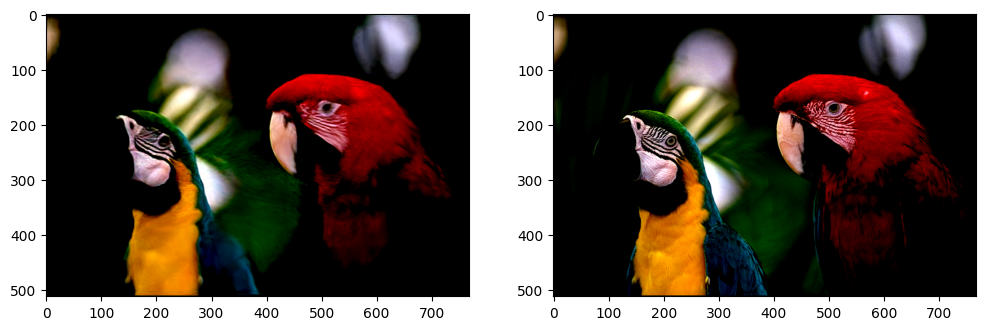

 67%|██████▋   | 6700/10000 [14:20<06:54,  7.97it/s]

Step 6700, Loss 0.172212


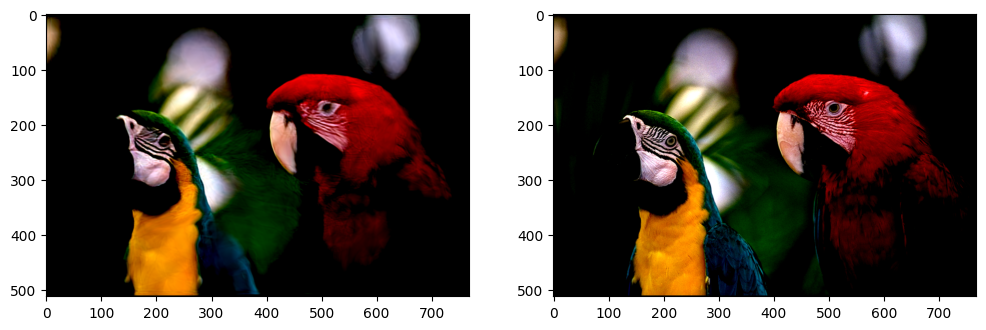

 68%|██████▊   | 6800/10000 [14:33<06:40,  7.98it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2781656].


Step 6800, Loss 0.171867


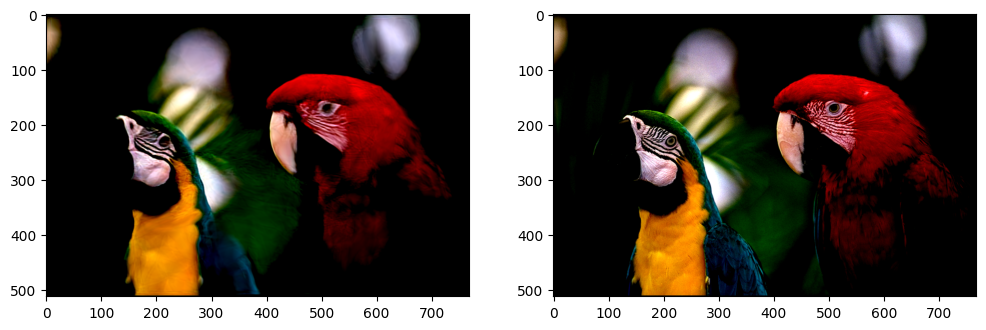

 69%|██████▉   | 6900/10000 [14:46<06:30,  7.95it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.245778].


Step 6900, Loss 0.171799


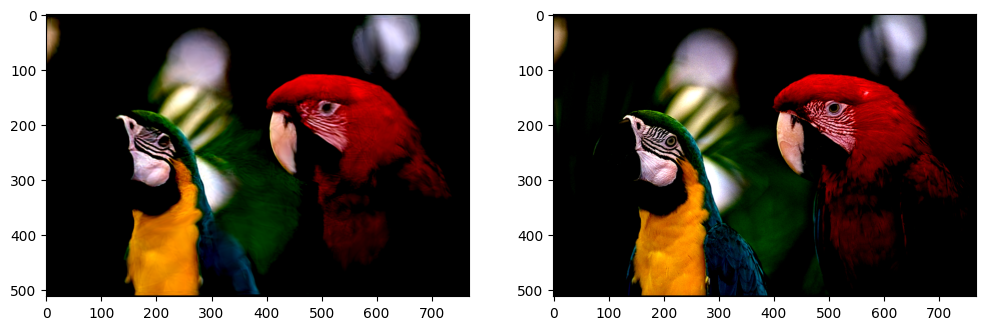

 70%|███████   | 7000/10000 [14:59<06:16,  7.97it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.1923482].


Step 7000, Loss 0.171952


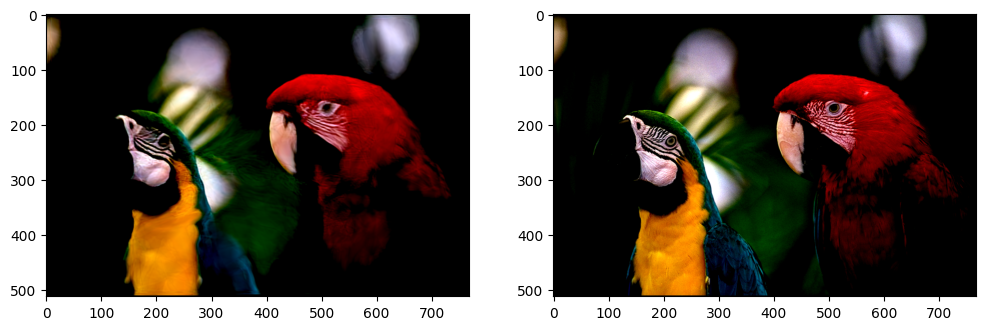

 71%|███████   | 7100/10000 [15:12<06:04,  7.96it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2028723].


Step 7100, Loss 0.171912


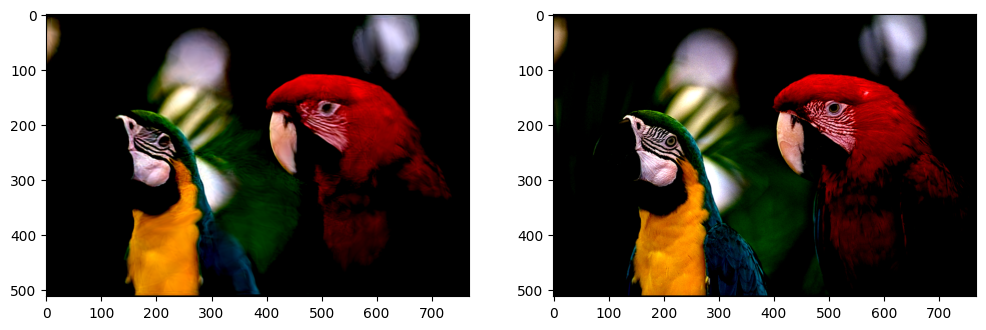

 72%|███████▏  | 7200/10000 [15:25<05:49,  8.00it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.1906615].


Step 7200, Loss 0.171927


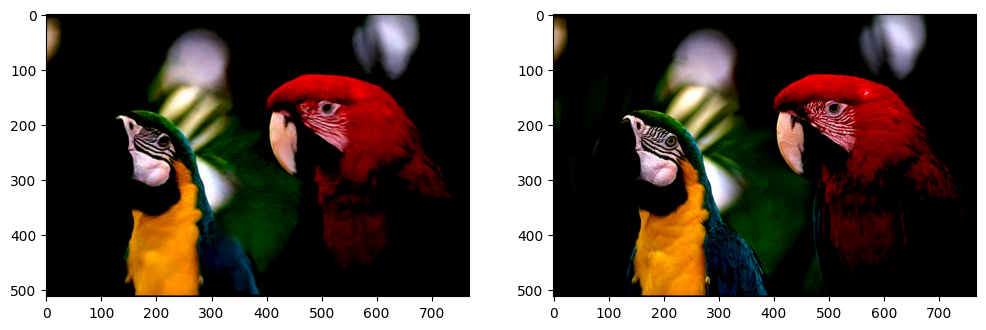

 73%|███████▎  | 7300/10000 [15:38<05:37,  8.00it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.1662289].


Step 7300, Loss 0.171905


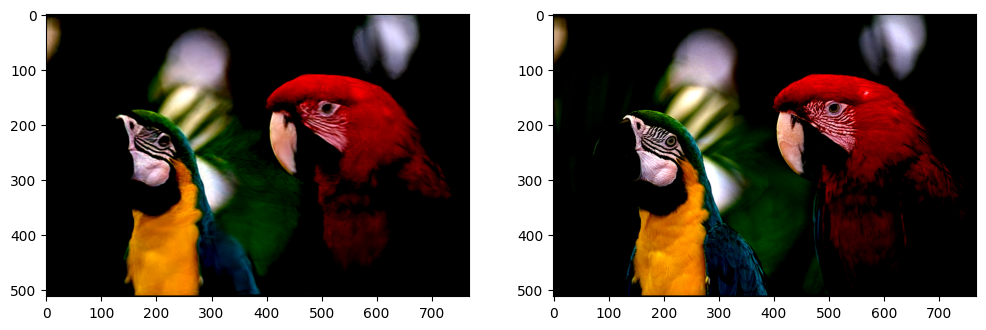

 74%|███████▍  | 7400/10000 [15:51<05:25,  7.99it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.270079].


Step 7400, Loss 0.171923


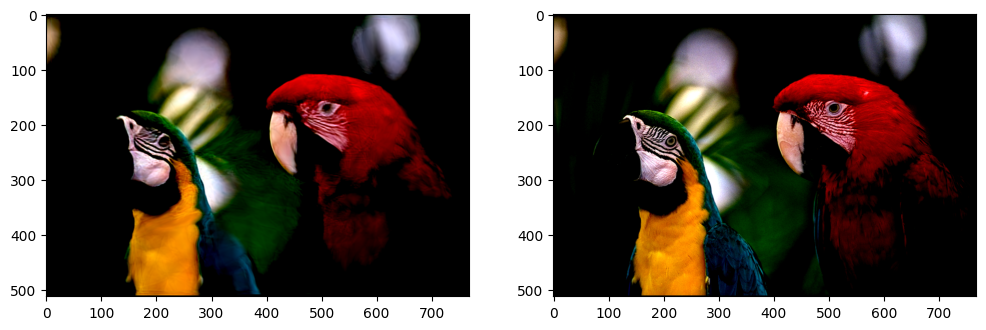

 75%|███████▌  | 7500/10000 [16:04<05:13,  7.99it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2273879].


Step 7500, Loss 0.172023


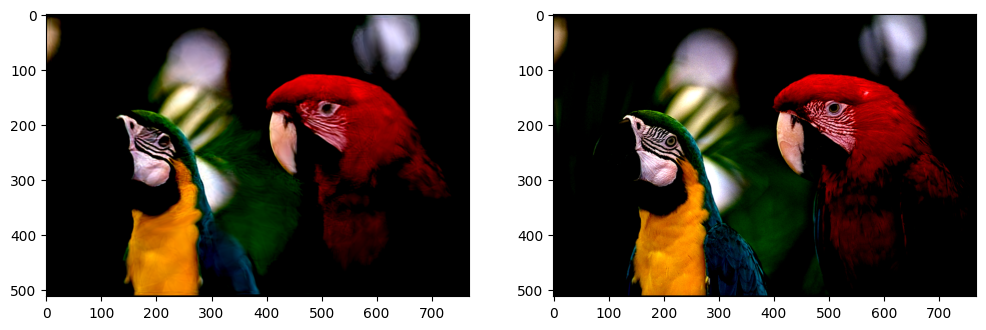

 76%|███████▌  | 7600/10000 [16:17<05:00,  7.99it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.1938419].


Step 7600, Loss 0.171744


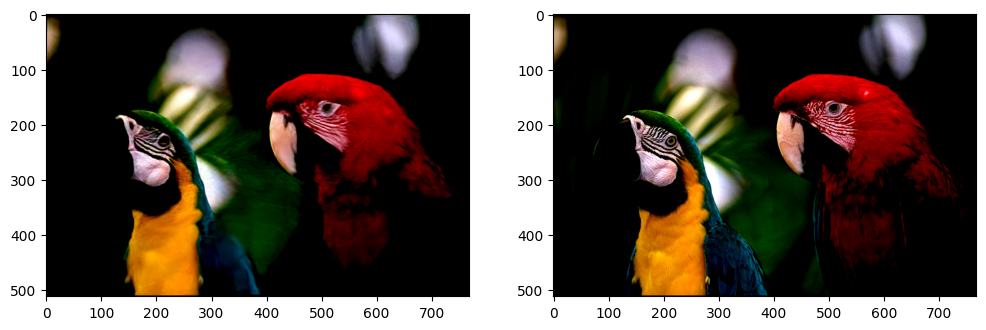

 77%|███████▋  | 7700/10000 [16:30<04:48,  7.96it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2395344].


Step 7700, Loss 0.171877


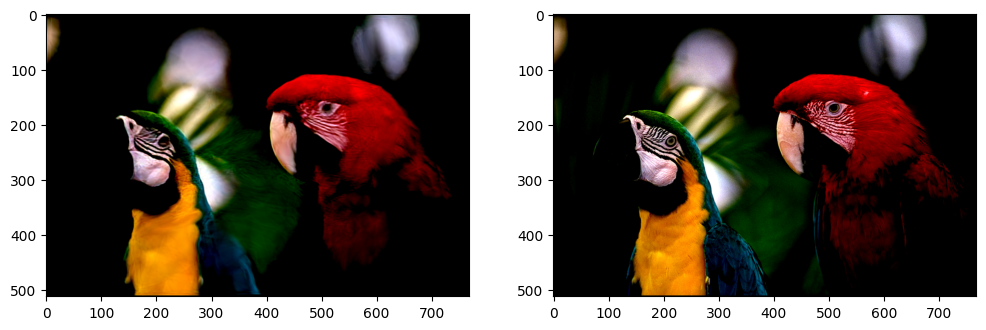

 78%|███████▊  | 7800/10000 [16:43<04:35,  7.98it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2559282].


Step 7800, Loss 0.171883


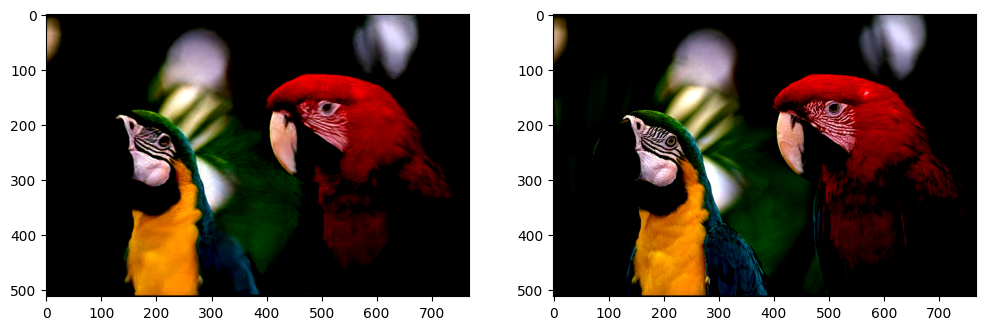

 79%|███████▉  | 7900/10000 [16:56<04:23,  7.96it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.1649549].


Step 7900, Loss 0.172277


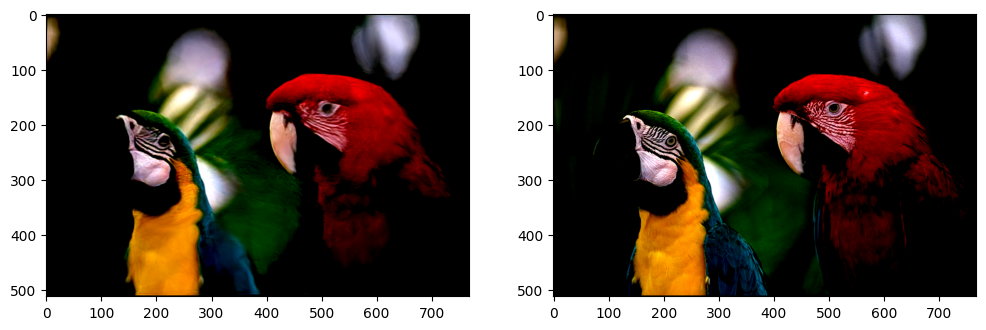

 80%|████████  | 8000/10000 [17:09<04:11,  7.96it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2188641].


Step 8000, Loss 0.171859


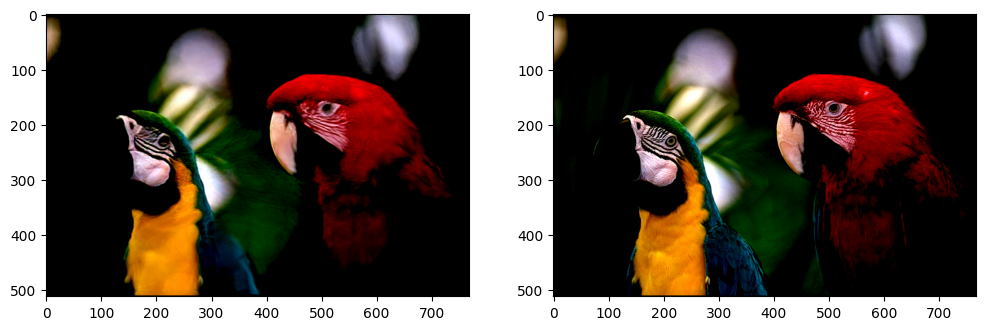

 81%|████████  | 8100/10000 [17:22<03:58,  7.97it/s]

Step 8100, Loss 0.172029


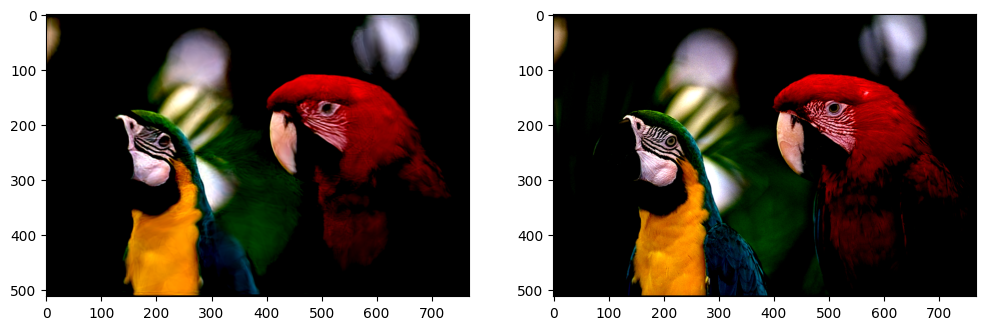

 82%|████████▏ | 8200/10000 [17:35<03:45,  7.98it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.1763954].


Step 8200, Loss 0.171749


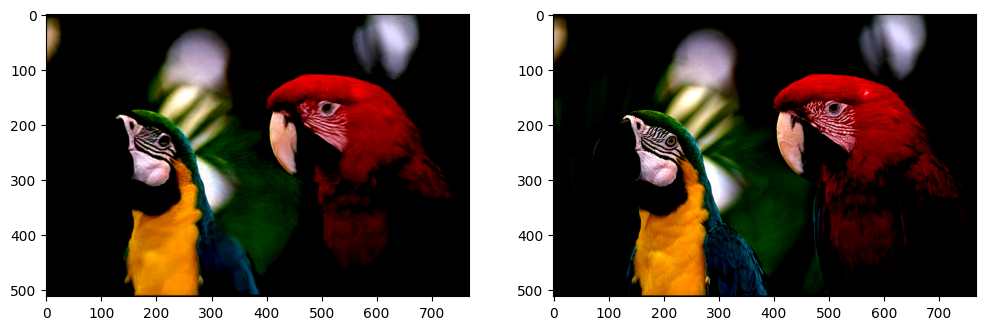

 83%|████████▎ | 8300/10000 [17:48<03:32,  7.99it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.1856471].


Step 8300, Loss 0.171923


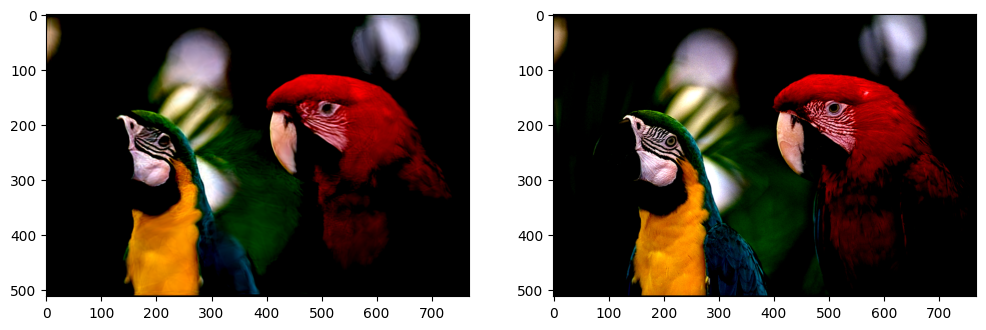

 84%|████████▍ | 8400/10000 [18:01<03:20,  7.98it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.213833].


Step 8400, Loss 0.171715


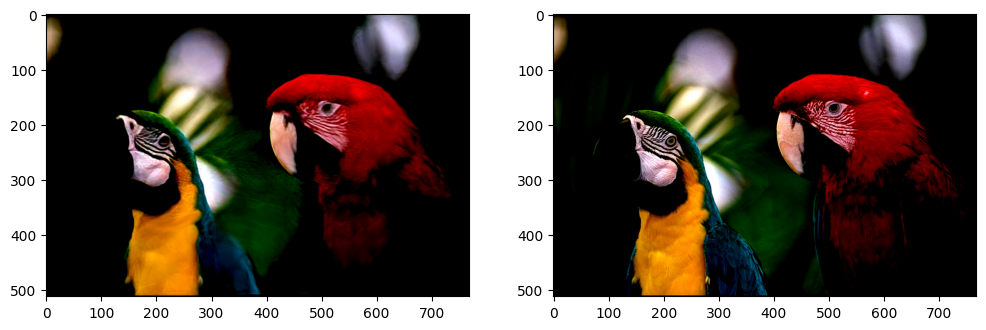

 85%|████████▌ | 8500/10000 [18:14<03:07,  7.99it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2015655].


Step 8500, Loss 0.171846


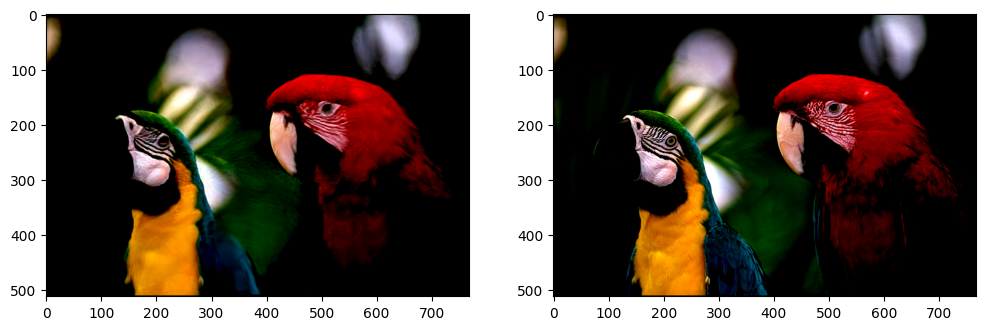

 86%|████████▌ | 8600/10000 [18:27<02:55,  7.97it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2117219].


Step 8600, Loss 0.171940


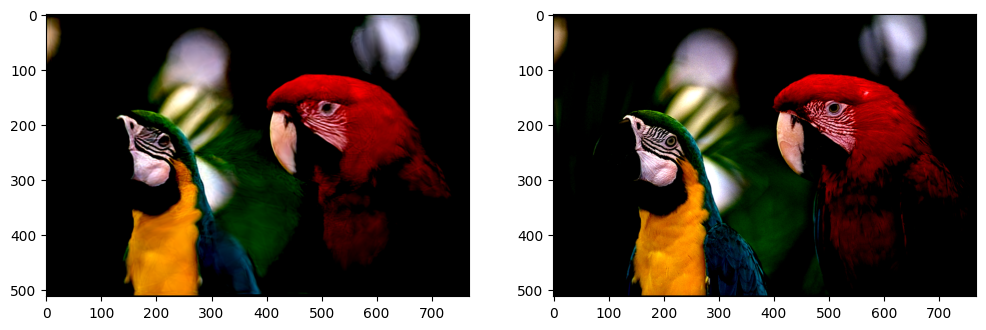

 87%|████████▋ | 8700/10000 [18:40<02:43,  7.97it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2048181].


Step 8700, Loss 0.171994


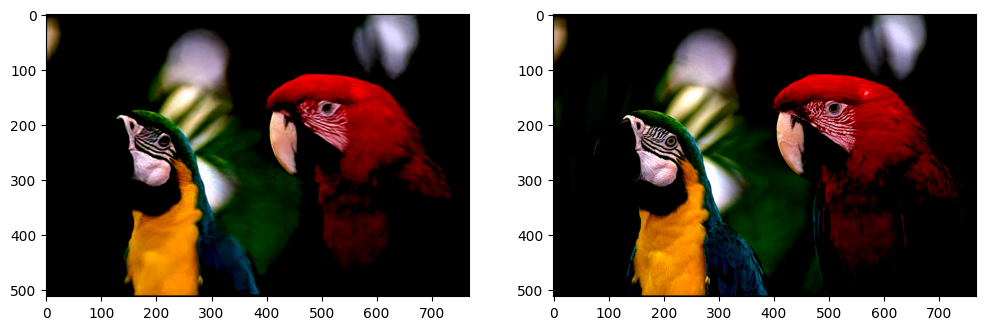

 88%|████████▊ | 8800/10000 [18:53<02:30,  7.97it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2233024].


Step 8800, Loss 0.172046


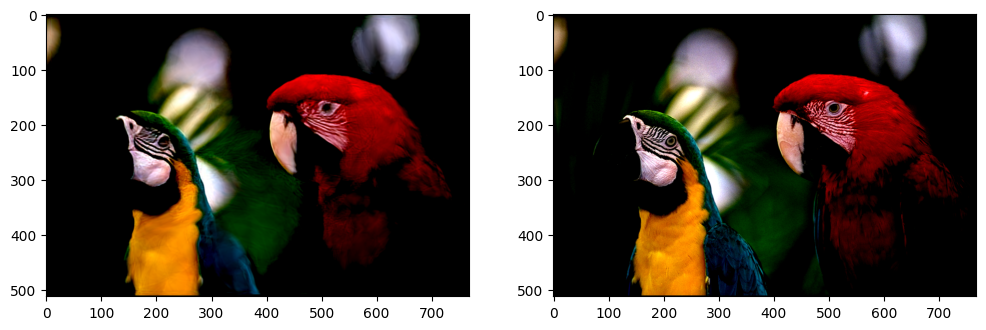

 89%|████████▉ | 8900/10000 [19:06<02:18,  7.95it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.1640599].


Step 8900, Loss 0.171786


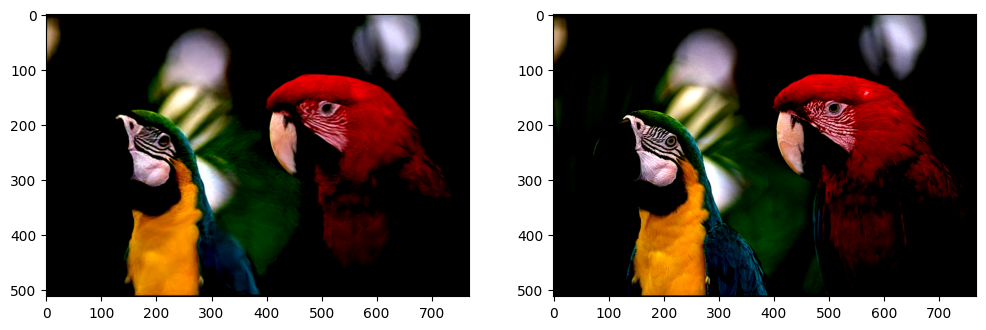

 90%|█████████ | 9000/10000 [19:19<02:05,  7.97it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2239786].


Step 9000, Loss 0.171730


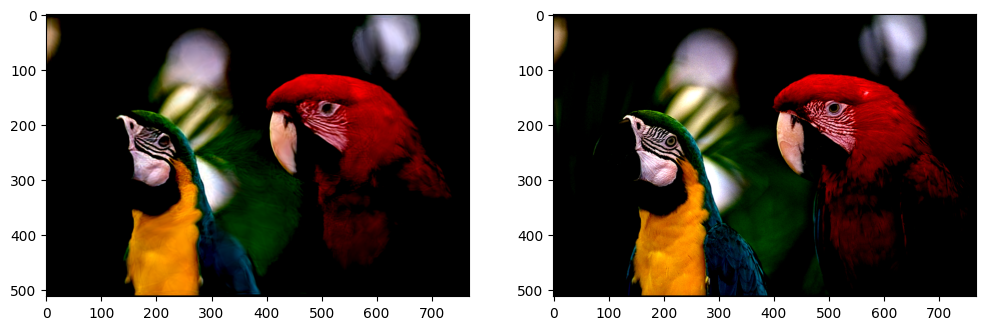

 91%|█████████ | 9100/10000 [19:32<01:53,  7.94it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2986379].


Step 9100, Loss 0.171914


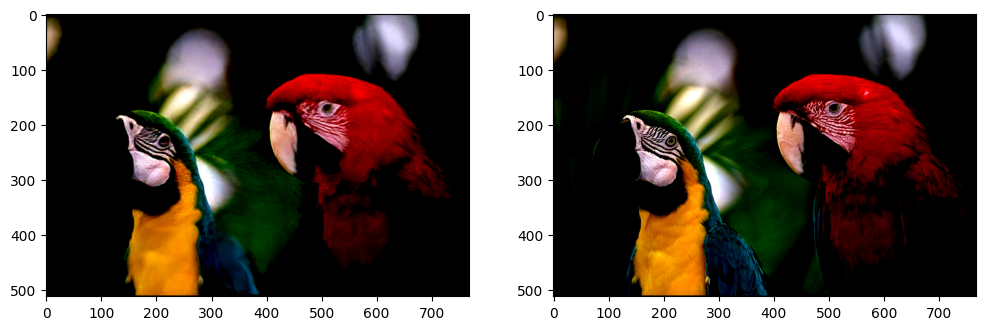

 92%|█████████▏| 9200/10000 [19:46<01:40,  7.96it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.3584752].


Step 9200, Loss 0.171862


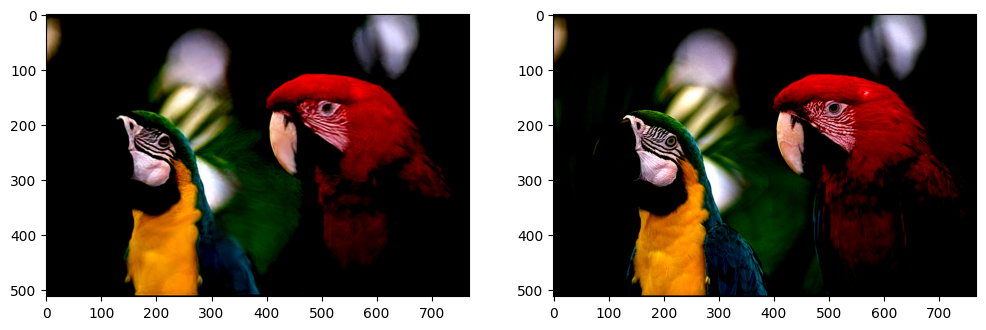

 93%|█████████▎| 9300/10000 [19:59<01:27,  7.99it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.236888].


Step 9300, Loss 0.171683


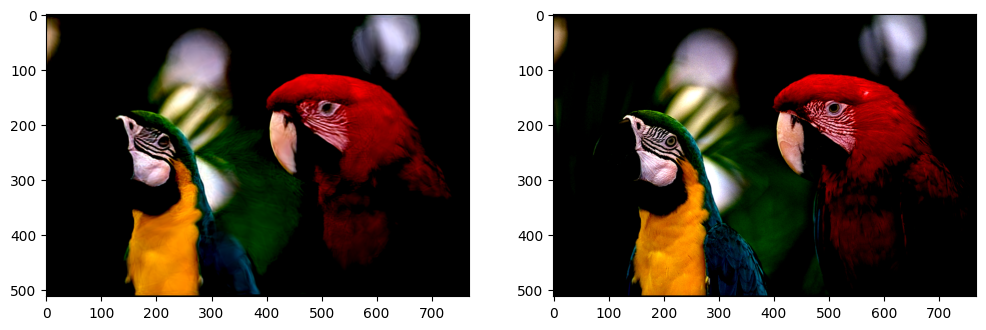

 94%|█████████▍| 9400/10000 [20:12<01:15,  7.99it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2100523].


Step 9400, Loss 0.171576


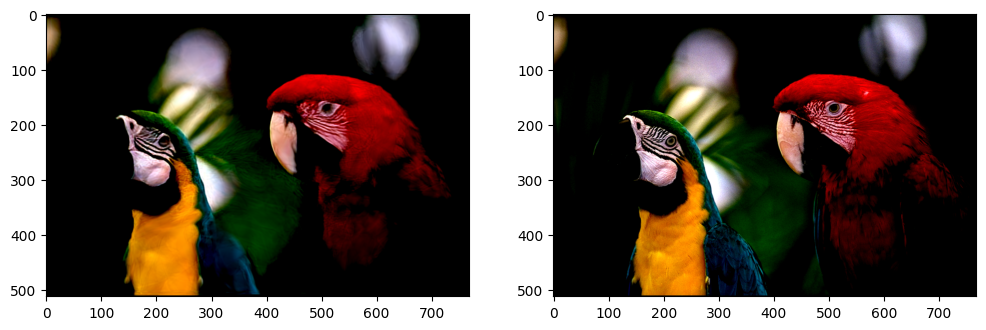

 95%|█████████▌| 9500/10000 [20:25<01:02,  7.96it/s]

Step 9500, Loss 0.171701


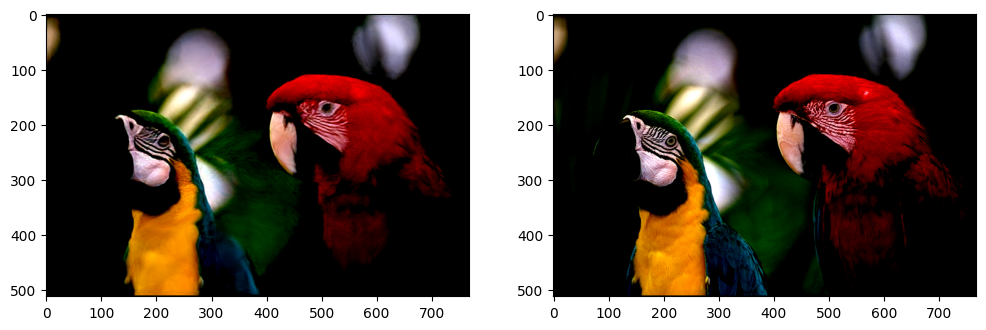

 96%|█████████▌| 9600/10000 [20:38<00:50,  7.97it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2178755].


Step 9600, Loss 0.171816


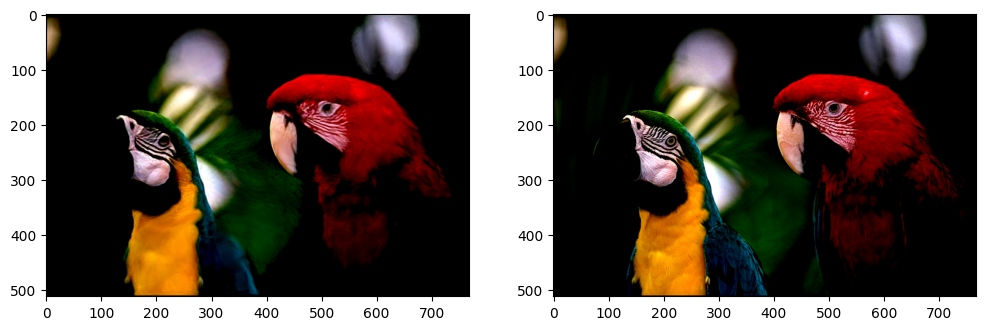

 97%|█████████▋| 9700/10000 [20:51<00:37,  7.97it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2018341].


Step 9700, Loss 0.171698


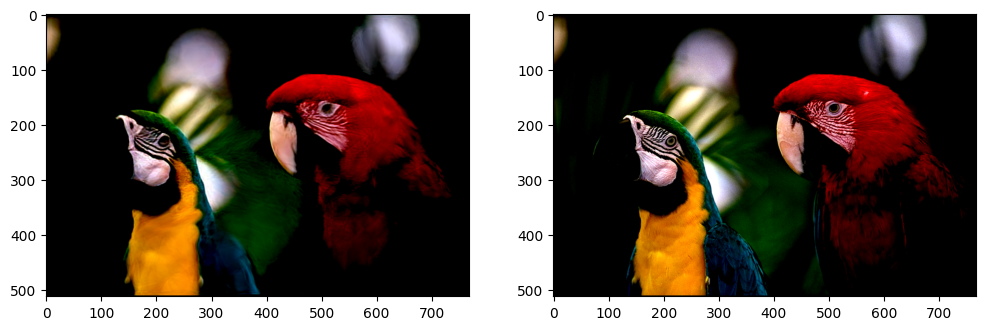

 98%|█████████▊| 9800/10000 [21:04<00:25,  7.94it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.253949].


Step 9800, Loss 0.171515


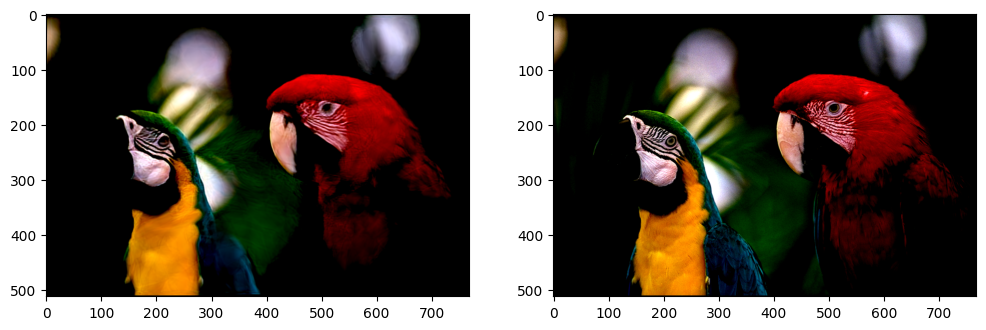

 99%|█████████▉| 9900/10000 [21:17<00:12,  7.97it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2433944].


Step 9900, Loss 0.171876


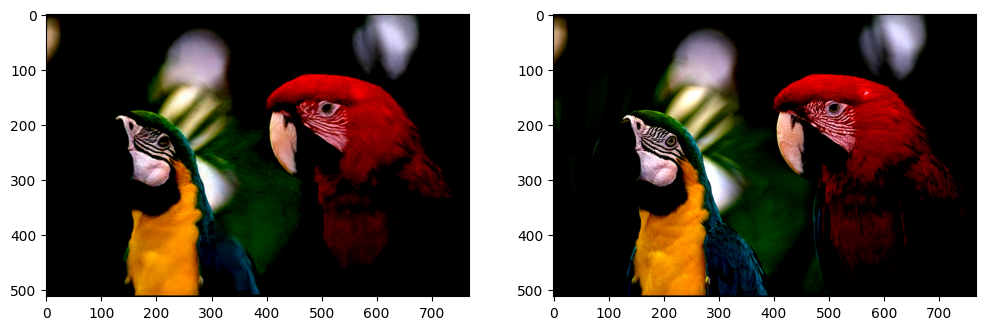

100%|██████████| 10000/10000 [21:30<00:00,  7.75it/s]


In [ ]:
total_steps = 10000
steps_til_summary = 100

optim = torch.optim.Adam(img_cnn.parameters(), lr=2e-4)

loss = nn.MSELoss()

train_conv_inr(img_cnn, optim, loss, dataloader, total_steps)